# Clustering 

## Objectifs:

- Segmenter les consommateurs sur la base de segmentation RFM
- Utilisation des apprentissage non supervisé de clustering (clustering hiérachique, k-means et DBSCAN)
- Voir les effets d'ajout de features

## Imports

In [1]:
import pandas as pd
import numpy as np
import scipy as sp
import missingno as msno

import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
from sklearn.decomposition import PCA
from yellowbrick.cluster import SilhouetteVisualizer, InterclusterDistance
from sklearn import cluster, preprocessing, manifold, model_selection, metrics, impute

from sklearn.compose import ColumnTransformer
from sklearn.pipeline import make_pipeline, Pipeline 
from sklearn.compose import make_column_transformer

import seaborn as sns

import warnings

#### Message d'avertissement

In [2]:
warnings.filterwarnings("ignore")

#### Dimension DataFramme

In [3]:
pd.set_option('display.max_columns', 200)
pd.set_option('display.max_rows', 1000)

#### Import dataset

In [4]:
data = pd.read_csv("./Data/Data_Olist.csv")

In [5]:
data.drop('Unnamed: 0', axis = 1, inplace = True)
data['date_dernier_achat']= data['date_dernier_achat'].astype('datetime64[ns]')

In [6]:
data.dtypes

id_client                     object
code_postal                    int64
ville                         object
region                        object
nombre_commande                int64
date_dernier_achat    datetime64[ns]
nombre_paiement                int64
montant_total                float64
note                           int64
nombre_produit                 int64
prix_produit                 float64
prix_frais_de_port           float64
categorie                     object
recence                        int64
groupe                        object
dtype: object

In [7]:
df = data.copy()

In [8]:
df.loc[df['nombre_paiement']==0]

,id_client,code_postal,ville,region,nombre_commande,date_dernier_achat,nombre_paiement,montant_total,note,nombre_produit,prix_produit,prix_frais_de_port,categorie,recence,groupe
67250,f54cea27c80dc09bfe07b1cf1e01b845,5263,sao paulo,SP,1,2018-04-22 11:34:42,0,58.69,5,1,45.90,12.79,telephony,161,telephony
87186,9925e1d7dff0d807355599dee04830ab,44001,feira de santana,BA,1,2018-05-15 16:25:14,0,129.94,5,2,83.38,46.56,housewares,138,home


In [9]:
df.loc[67250,'nombre_paiement'] =1
df.loc[87186,'nombre_paiement'] =1

## Segmentation RFM

- Segmentation RFM etablir un scoring par quantile pour les variable recence, fréquence et montant
- Segmenter en 3 puis 4 clusters
- Segmenter en 11 clusters (technique des 11 segments)

In [9]:
rfm = df[['id_client','recence', 'nombre_commande', 'montant_total']]

In [10]:
for r, l in rfm.iterrows():
    
    # Scoring récence
    if l['recence'] < rfm['recence'].quantile(q=0.2):
        rfm.loc[r, 'Scoring_R'] = 5
    elif l['recence'] < rfm['recence'].quantile(q=0.4):
        rfm.loc[r, 'Scoring_R'] = 4
    elif l['recence'] < rfm['recence'].quantile(q=0.6):
        rfm.loc[r, 'Scoring_R'] = 3
    elif l['recence'] < rfm['recence'].quantile(q=0.8):
        rfm.loc[r, 'Scoring_R'] = 2
    else:
        rfm.loc[r, 'Scoring_R'] = 1
        
    # Scoring Fréquence
    if l['nombre_commande'] < rfm['nombre_commande'].quantile(q=0.2):
        rfm.loc[r, 'Scoring_F'] = 1
    elif l['nombre_commande'] < rfm['nombre_commande'].quantile(q=0.4):
        rfm.loc[r, 'Scoring_F'] = 2
    elif l['nombre_commande'] < rfm['nombre_commande'].quantile(q=0.6):
        rfm.loc[r, 'Scoring_F'] = 3
    elif l['nombre_commande'] < rfm['nombre_commande'].quantile(q=0.8):
        rfm.loc[r, 'Scoring_F'] = 4
    else:
        rfm.loc[r, 'Scoring_F'] = 5
        
    # Scoring Montant
    if l['montant_total'] < rfm['montant_total'].quantile(q=0.2):
        rfm.loc[r, 'Scoring_M'] = 1
    elif l['montant_total'] < rfm['montant_total'].quantile(q=0.4):
        rfm.loc[r, 'Scoring_M'] = 2
    elif l['montant_total'] < rfm['montant_total'].quantile(q=0.6):
        rfm.loc[r, 'Scoring_M'] = 3
    elif l['montant_total'] < rfm['montant_total'].quantile(q=0.8):
        rfm.loc[r, 'Scoring_M'] = 4
    else:
        rfm.loc[r, 'Scoring_M'] = 5

#### Segmentation en 3 et 4 Clusters 

In [11]:
#Conversion en entier puis somme des colonnes de scoring
rfm[['Scoring_R','Scoring_F','Scoring_M']] = rfm[['Scoring_R','Scoring_F','Scoring_M']].astype('int')
rfm['Scoring_RFM'] = rfm[['Scoring_R','Scoring_F','Scoring_M']].sum(axis=1)

In [12]:
# Segmentation en 3
for r, l in rfm.iterrows():
    if 3 <= l['Scoring_RFM'] <= 7:
        rfm.loc[r, 'Seg_3'] = 'New Customers'
    elif 7 < l['Scoring_RFM'] <= 11:
        rfm.loc[r, 'Seg_3'] = 'Potential Loyalist'
    elif 11 < l['Scoring_RFM'] <= 15:
        rfm.loc[r, 'Seg_3'] = 'Champion'
        
# Segmentation en 4       
for r, l in rfm.iterrows():
    if 3 <= l['Scoring_RFM'] <= 6:
        rfm.loc[r, 'Seg_4'] = 'New Customers'
    elif 6 < l['Scoring_RFM'] <= 9:
        rfm.loc[r, 'Seg_4'] = 'At Risk'
    elif 9 < l['Scoring_RFM'] <= 12:
        rfm.loc[r, 'Seg_4'] = 'Potential Loyalist'
    elif 12 < l['Scoring_RFM'] <= 15:
        rfm.loc[r, 'Seg_4'] = 'Champion'

#### Segmentation En 11 segments

les raisons de la répartition des segments:
https://documentation.bloomreach.com/engagement/docs/rfm-segmentation

In [13]:
#Conversion des colonnes pour créer une colonne segmentation RFM
rfm_str = rfm[['Scoring_R','Scoring_F','Scoring_M']].astype('str')
rfm['Seg_RFM'] = rfm_str['Scoring_R'] + rfm_str ['Scoring_F'] + rfm_str['Scoring_M']

In [14]:
champions = [ "555","554","544","545","454","455","445"]
loyal = ["543","444","435","355","354","345","344","335"]
pot_loyal =["553","551","552","541","542","533","532","531","452","451","442",\
            "441","431","453","433","432","423","353","352","351","342","341","333","323"]
new_cus = ["512","511","422","421","412","411","311"]
promis = ["525","524","523","522","521","515","514","513","425","424","413","414","415","315","314","313"]
need = ["535","534","443","434","343","334","325","324"]
sleep = ["331","321","312","221","213","231","241","251"]
risk = ["255","254","245","244","253","252","243","242","235","234","225","224",\
       "153","152","145","143","142","135","134","133","125","124"]
lose = ["155","154","144","214","215","115","114","113"]
hiber = ["332","322","233","232","223","222","132","123","122","212","211"]
lost_cus = ["111","112","121","131","141","151"]


for r, l in rfm.iterrows():
    if l['Seg_RFM'] in champions:
        rfm.loc[r, 'Seg_11'] = "Champions"
    elif l['Seg_RFM'] in loyal:
        rfm.loc[r, 'Seg_11'] = "Loyals"
    elif l['Seg_RFM'] in pot_loyal:
        rfm.loc[r, 'Seg_11'] = "Potential Loyalist"
    elif l['Seg_RFM'] in new_cus:
        rfm.loc[r, 'Seg_11'] = "New Customers"
    elif l['Seg_RFM'] in promis:
        rfm.loc[r, 'Seg_11'] = "Promising"
    elif l['Seg_RFM'] in need:
        rfm.loc[r, 'Seg_11'] = "Need Attention"
    elif l['Seg_RFM'] in sleep:
        rfm.loc[r, 'Seg_11'] = "About To Sleep"
    elif l['Seg_RFM'] in risk:
        rfm.loc[r, 'Seg_11'] = "At Risk"
    elif l['Seg_RFM'] in lose:
        rfm.loc[r, 'Seg_11'] = "Cannot Lose Them"
    elif l['Seg_RFM'] in hiber:
        rfm.loc[r, 'Seg_11'] = "Hibernating customers"
    elif l['Seg_RFM'] in lost_cus:
        rfm.loc[r, 'Seg_11'] = "Lost Customers"

In [15]:
rfm

,id_client,recence,nombre_commande,montant_total,Scoring_R,Scoring_F,Scoring_M,Scoring_RFM,Seg_3,Seg_4,Seg_RFM,Seg_11
0,861eff4711a542e4b93843c6dd7febb0,502,1,146.87,1,5,4,10,Potential Loyalist,Potential Loyalist,154,Cannot Lose Them
1,290c77bc529b7ac935b93aa66c333dc3,261,1,335.48,3,5,5,13,Champion,Champion,355,Loyals
2,060e732b5b29e8181a18229c7b0b2b5e,134,1,157.73,4,5,4,13,Champion,Champion,454,Champions
3,259dac757896d24d7702b9acbbff3f3c,201,1,173.30,4,5,4,13,Champion,Champion,454,Champions
4,345ecd01c38d18a9036ed96c73b8d066,63,1,252.25,5,5,5,15,Champion,Champion,555,Champions
...,...,...,...,...,...,...,...,...,...,...,...,...
94984,4881e59e3733f4660a0e6412d25d9d02,42,1,246.44,5,5,5,15,Champion,Champion,555,Champions
94985,7ec163471da7520f672fef86422f42d5,428,1,176.16,1,5,4,10,Potential Loyalist,Potential Loyalist,154,Cannot Lose Them
94986,6d443b75cff956bb73dce7385033e266,390,1,441.05,2,5,5,12,Champion,Potential Loyalist,255,At Risk
94987,b6108acc674ae5c99e29adc1047d1049,513,1,399.28,1,5,5,11,Potential Loyalist,Potential Loyalist,155,Cannot Lose Them


#### Visualisation
- Comparaison des différents clusterings

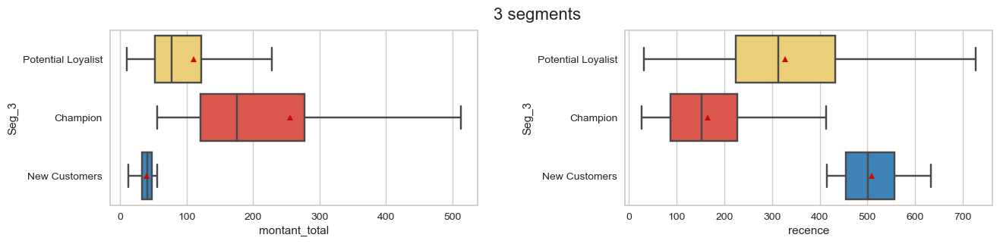

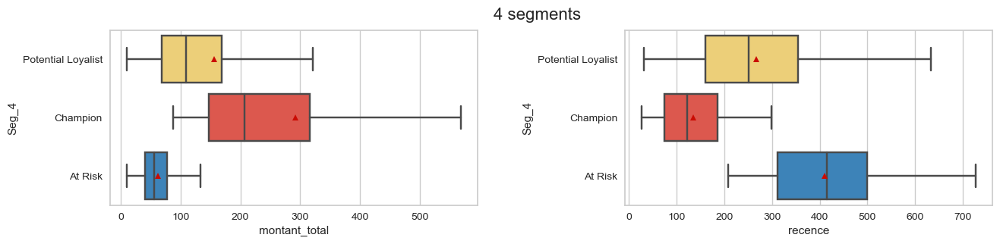

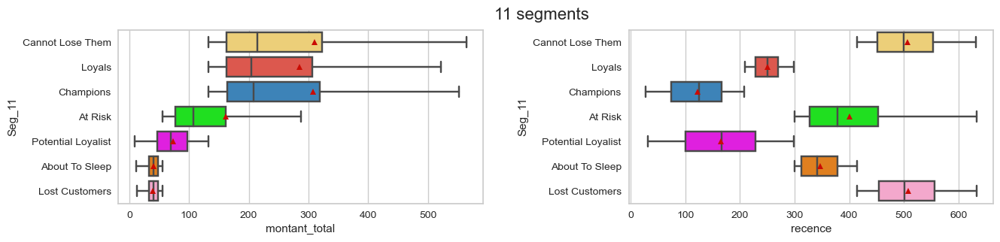

In [16]:
colors=['#ffd966', '#f44336', '#2986cc', '#00FF00', '#FF00FF', '#ff7f00', '#FF9CCB']

# Avec les 3 Clusters
plt.figure(figsize=(15,3))
plt.subplot(1,2,1)
sns.boxplot(data = rfm, x = 'montant_total', y= "Seg_3", showfliers=False, showmeans=True, palette=colors)
plt.subplot(1,2,2)
sns.boxplot(data = rfm, x = 'recence', y= "Seg_3", showfliers=False, showmeans=True, palette=colors)
plt.suptitle("3 segments", fontsize=16)
plt.subplots_adjust(hspace=0.45,wspace=0.40)
plt.savefig("./Visualisations/Boxplot_seg3", bbox_inches='tight')
plt.show()
# Avec les 4 Clusters
plt.figure(figsize=(15,3))
plt.subplot(1,2,1)
sns.boxplot(data = rfm, x = 'montant_total', y= "Seg_4", showfliers=False, showmeans=True, palette=colors)
plt.subplot(1,2,2)
sns.boxplot(data = rfm, x = 'recence', y= "Seg_4", showfliers=False, showmeans=True, palette=colors)
plt.suptitle("4 segments", fontsize=16)
plt.subplots_adjust(hspace=0.45,wspace=0.40)
plt.savefig("./Visualisations/Boxplot_seg4", bbox_inches='tight')
plt.show()
# Avec les 11 Clusters
plt.figure(figsize=(15,3))
plt.subplot(1,2,1)
sns.boxplot(data = rfm, x = 'montant_total', y= "Seg_11", showfliers=False, showmeans=True, palette=colors)
plt.subplot(1,2,2)
sns.boxplot(data = rfm, x = 'recence', y= "Seg_11", showfliers=False, showmeans=True, palette=colors)
plt.suptitle("11 segments", fontsize=16)
plt.subplots_adjust(hspace=0.45,wspace=0.40)
plt.savefig("./Visualisations/Boxplot_seg11", bbox_inches='tight')
plt.show()

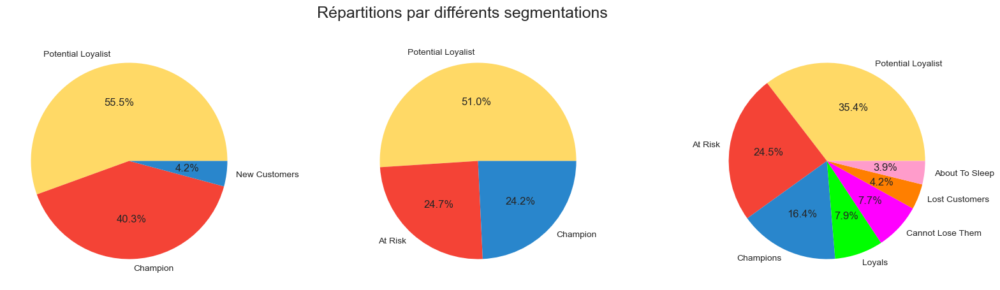

In [17]:
plt.figure(figsize=(20,5))
plt.subplot(1,3,1)
seg3 = rfm['Seg_3'].value_counts()
plt.pie(seg3, labels= seg3.index, autopct='%1.1f%%', colors=colors)
plt.subplot(1,3,2)
seg4 = rfm['Seg_4'].value_counts()
plt.pie(seg4, labels= seg4.index, autopct='%1.1f%%', colors=colors)
plt.subplot(1,3,3)
seg11 = rfm['Seg_11'].value_counts()
plt.pie(seg11, labels= seg11.index, autopct='%1.1f%%', colors=colors)
plt.suptitle("Répartitions par différents segmentations", fontsize=18)
plt.savefig("./Visualisations/Repartitions_seg", bbox_inches='tight')
plt.show()

Observations: 
- Les 11 segments ont seulement 7 clusters
- Les 4 segments ont seulement 3 clusters

## Réduction de dimensions

Test de t-SNE et l'ACP pour le cas où on a les variable Récence, Fréquence et Montant Total en se fiant sur les clusters définis par le scoring RFM

### t-SNE
- Premiere boucle pour tester la perplexité avec un nombre d'itérations fixe
- Deuxieme boucle pour tester le nombre d'itérations avec la perplexité fixe

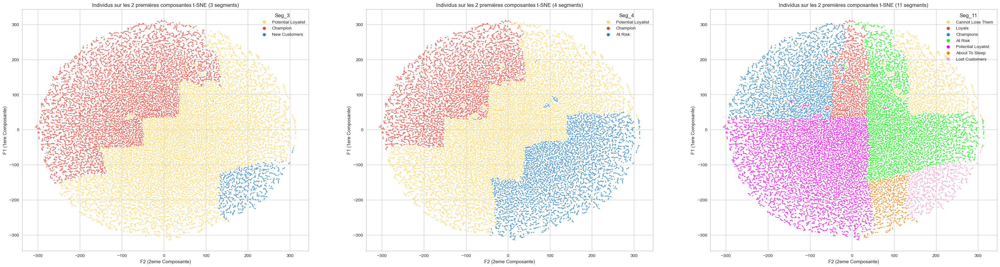

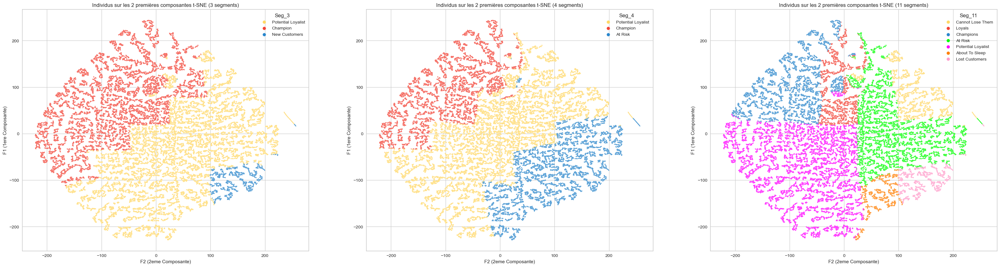

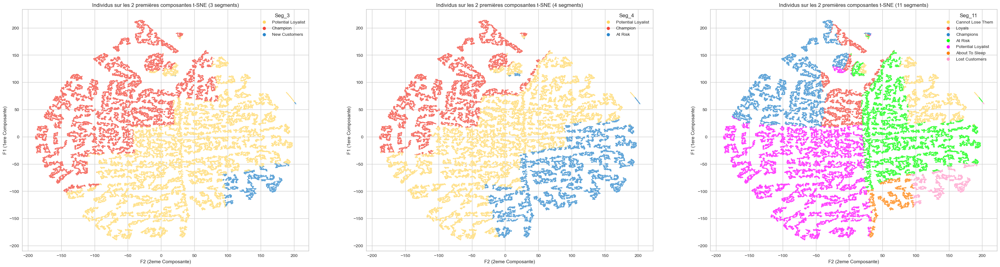

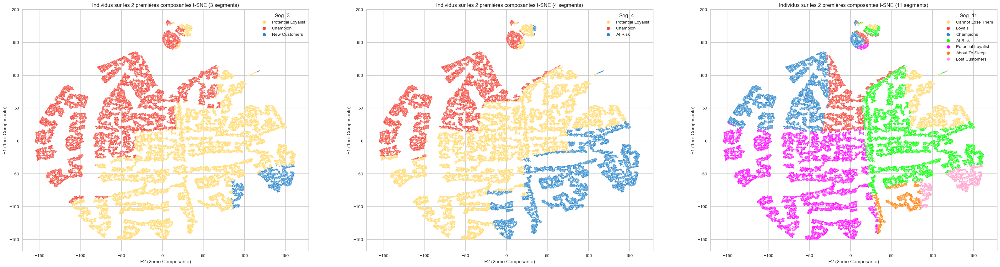

In [18]:
X = df[['recence','nombre_commande', 'montant_total']]
X_s = pd.DataFrame(columns=['recence','nombre_commande', 'montant_total'])
X_s['recence'] = preprocessing.scale(X['recence'])
X_s['nombre_commande'] = X['nombre_commande']
X_s[ 'montant_total'] = np.log1p(X[ 'montant_total'])

for n in [5, 30, 50, 100]:
    tsne = manifold.TSNE(n_components=2, perplexity=n, n_iter=5000, init='pca', n_jobs = -1)
    df_tsne= tsne.fit_transform(X_s)

    plt.figure(figsize=(40,10))
    plt.subplot(1,3,1)
    sns.scatterplot( y=  df_tsne[:,1], x= df_tsne[:,0], hue=rfm['Seg_3'], s=3, palette=colors)
    plt.xlabel("F2 (2eme Composante)")
    plt.ylabel("F1 (1ere Composante)")
    plt.title("Individus sur les 2 premières composantes t-SNE (3 segments)")
    plt.subplot(1,3,2)
    sns.scatterplot( y=  df_tsne[:,1], x= df_tsne[:,0], hue=rfm['Seg_4'], s=3, palette=colors)
    plt.xlabel("F2 (2eme Composante)")
    plt.ylabel("F1 (1ere Composante)")
    plt.title("Individus sur les 2 premières composantes t-SNE (4 segments)")
    plt.subplot(1,3,3)
    sns.scatterplot( y=  df_tsne[:,1], x= df_tsne[:,0], hue=rfm['Seg_11'], s=3, palette=colors)
    plt.xlabel("F2 (2eme Composante)")
    plt.ylabel("F1 (1ere Composante)")
    plt.title("Individus sur les 2 premières composantes t-SNE (11 segments)")
    plt.savefig("./Visualisations/t_SNE_iter_5000_and_perpexité_{}".format(n), bbox_inches='tight')
    plt.show()


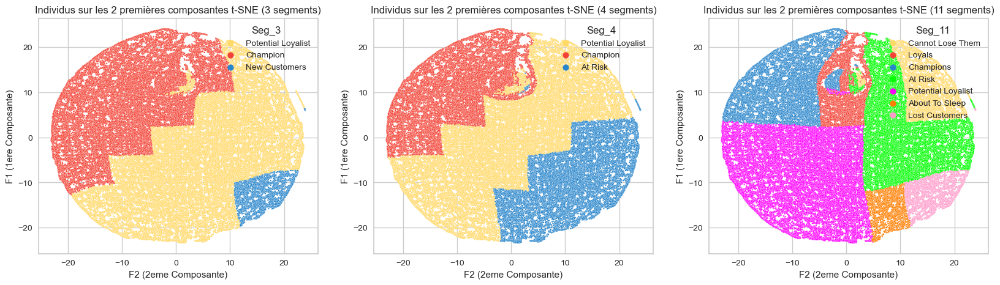

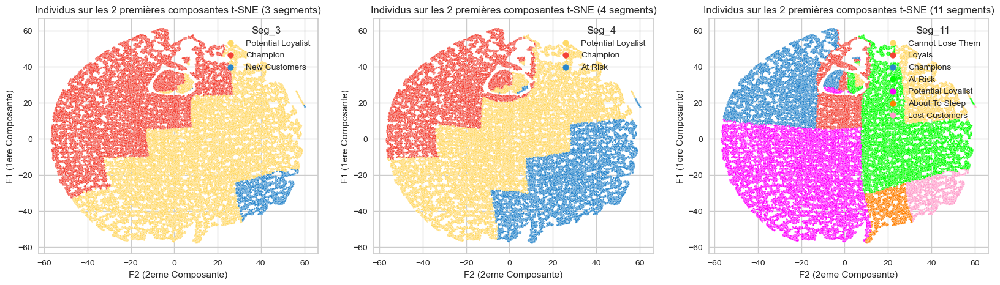

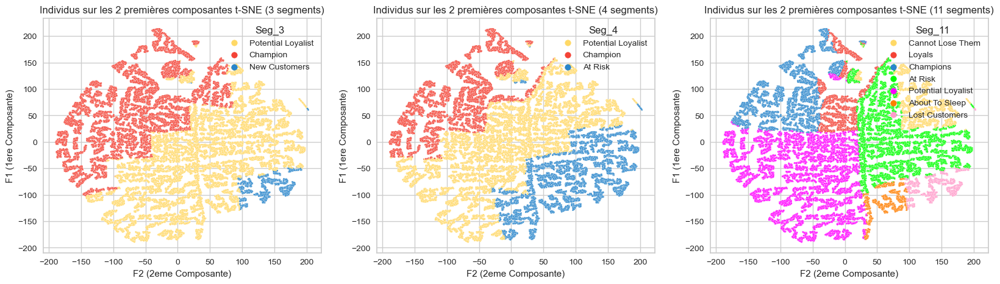

In [19]:
for n in [500, 1000, 5000]:
    tsne = manifold.TSNE(n_components=2, perplexity=50, n_iter=n, init='pca', n_jobs = -1)
    df_tsne= tsne.fit_transform(X_s)

    plt.figure(figsize=(20,5))
    plt.subplot(1,3,1)
    sns.scatterplot( y=  df_tsne[:,1], x= df_tsne[:,0], hue=rfm['Seg_3'], s=3, palette=colors)
    plt.xlabel("F2 (2eme Composante)")
    plt.ylabel("F1 (1ere Composante)")
    plt.title("Individus sur les 2 premières composantes t-SNE (3 segments)")
    plt.subplot(1,3,2)
    sns.scatterplot( y=  df_tsne[:,1], x= df_tsne[:,0], hue=rfm['Seg_4'], s=3, palette=colors)
    plt.title("Individus sur les 2 premières composantes t-SNE (4 segments)")
    plt.xlabel("F2 (2eme Composante)")
    plt.ylabel("F1 (1ere Composante)")
    plt.subplot(1,3,3)
    sns.scatterplot( y=  df_tsne[:,1], x= df_tsne[:,0], hue=rfm['Seg_11'], s=3, palette=colors)
    plt.xlabel("F2 (2eme Composante)")
    plt.ylabel("F1 (1ere Composante)")
    plt.title("Individus sur les 2 premières composantes t-SNE (11 segments)")
    plt.savefig("./Visualisations/t_SNE_iter_{}_and_perpexité_50".format(n), bbox_inches='tight')
    plt.show()


### ACP
Réduction de dimension et observation de l'inertie des 2 premières composantes

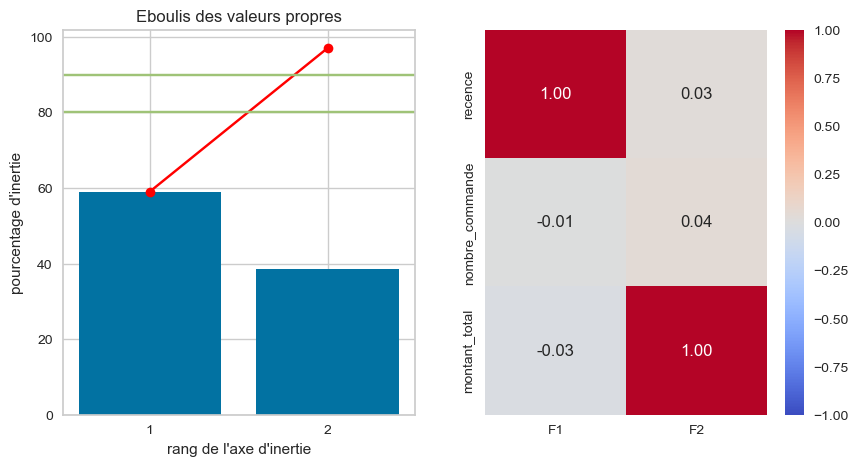

In [20]:
X = df[['recence','nombre_commande', 'montant_total']]
X_s = pd.DataFrame(columns=['recence','nombre_commande', 'montant_total'])
X_s['recence'] = preprocessing.scale(X['recence'])
X_s['nombre_commande'] = X['nombre_commande']
X_s[ 'montant_total'] = np.log1p(X[ 'montant_total'])

#ACP
pca = PCA(n_components=2)
pca.fit(X_s)
    
#Variance captée et éboulis de valeurs propres
scree = (pca.explained_variance_ratio_*100).round(2)
scree_cum = scree.cumsum().round()


    
# Composantes
pcs = pca.components_
pcs = pd.DataFrame(pcs)
pcs.columns = X_s.columns
x_list = list(range(1, 3))
pcs.index = [f"F{i}" for i in x_list]
pcs.T
    
#Visualisation des éboulis et la heatmap
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.bar(x_list, scree)
plt.plot(x_list, scree_cum, c="red", marker='o')
plt.xticks(range(1,3))
plt.xlabel("rang de l'axe d'inertie")
plt.ylabel("pourcentage d'inertie")
plt.axhline(y=80, color='g')
plt.axhline(y=90, color='g')
plt.title("Eboulis des valeurs propres")
plt.subplot(1,2,2)
sns.heatmap(pcs.T, vmin=-1, vmax=1, annot=True, cmap="coolwarm", fmt="0.2f")
plt.savefig("./Visualisations/Heatmap ACP", bbox_inches='tight')
plt.show()

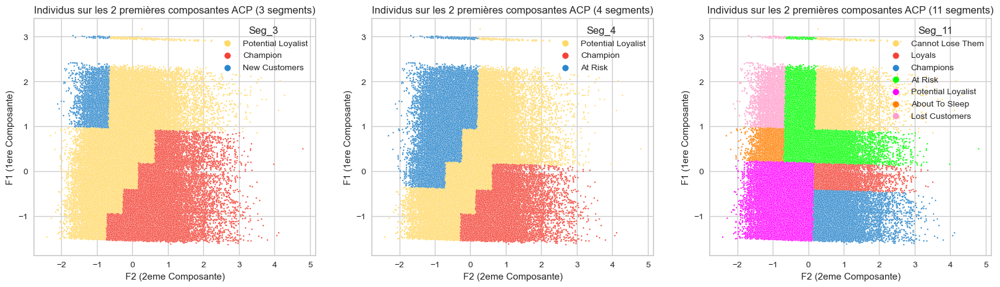

In [21]:
#Visualisation des individus sur les 2 premieres composantes
X_p = pca.fit_transform(X_s)
plt.figure(figsize=(20,5))
plt.subplot(1,3,1)
sns.scatterplot( x=  X_p[:,1], y= X_p[:,0], hue=rfm['Seg_3'], s=3, palette=colors)
plt.xlabel("F2 (2eme Composante)")
plt.ylabel("F1 (1ere Composante)")
plt.title("Individus sur les 2 premières composantes ACP (3 segments)")
plt.subplot(1,3,2)
sns.scatterplot( x=  X_p[:,1], y= X_p[:,0], hue=rfm['Seg_4'], s=3, palette=colors)
plt.xlabel("F2 (2eme Composante)")
plt.ylabel("F1 (1ere Composante)")
plt.title("Individus sur les 2 premières composantes ACP (4 segments)")
plt.subplot(1,3,3)
sns.scatterplot( x=  X_p[:,1], y= X_p[:,0], hue=rfm['Seg_11'], s=3, palette=colors)
plt.xlabel("F2 (2eme Composante)")
plt.ylabel("F1 (1ere Composante)")
plt.title("Individus sur les 2 premières composantes ACP (11 segments)")
plt.savefig("./Visualisations/ACP_segmentation", bbox_inches='tight')
plt.show()

## Choix des transformations

Les transformations seront appliquées sur les variables:
- variables numériques: montant_total, récence, prix_produit*, prix_frais_de_port* (Standardisation ou passage au log)
- variables catégorielles: région, catégorie (One-hot-Encoder)

les variables nombre_commande, nombre_paiement, note, nombre_produit ne subissent aucune transformation pour ne pas perdre la variance

*éventuellement

#### StandardScarler

In [22]:
X = df[['recence', 'montant_total', 'prix_produit', 'prix_frais_de_port']]
X_t = pd.DataFrame(columns=['recence', 'montant_total', 'prix_produit', 'prix_frais_de_port'])
X_t[['recence', 'montant_total', 'prix_produit', 'prix_frais_de_port']]=\
preprocessing.scale(X[['recence', 'montant_total', 'prix_produit', 'prix_frais_de_port']])

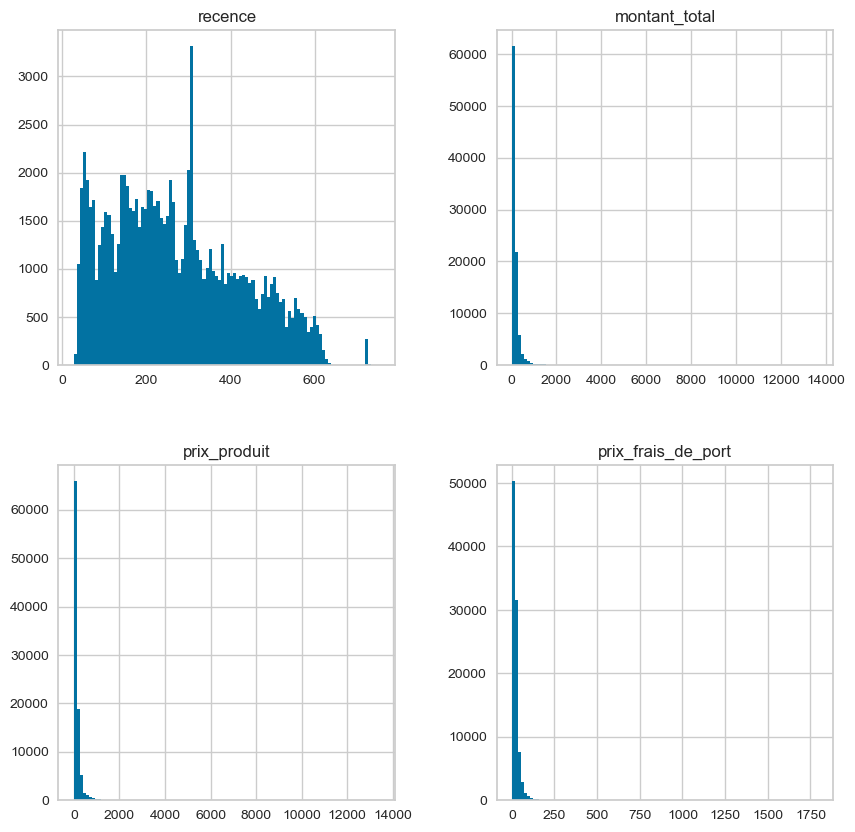

In [23]:
X.hist(figsize=(10,10), bins=100)
plt.savefig("./Visualisations/Base", bbox_inches='tight')
plt.show()

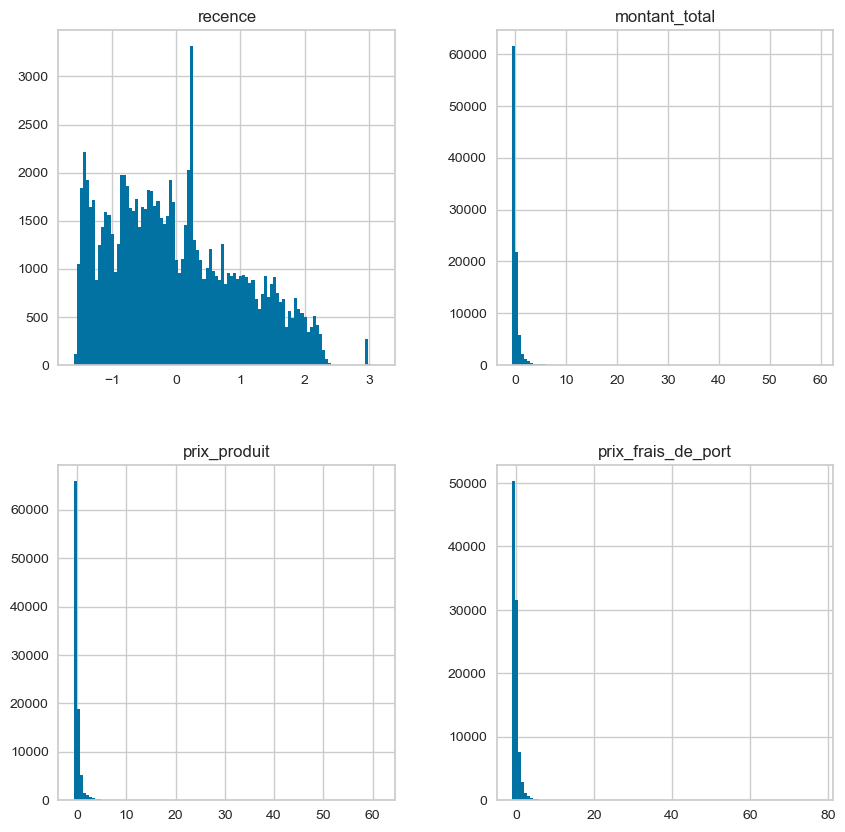

In [24]:
X_t.hist(figsize=(10,10), bins=100)
plt.savefig("./Visualisations/Transfo_Scaler", bbox_inches='tight')
plt.show()

#### Transformation log

In [25]:
X_t2 = pd.DataFrame(columns=['recence', 'montant_total', 'prix_produit', 'prix_frais_de_port'])
X_t2['recence'] = preprocessing.scale(X['recence'])
X_t2[['montant_total', 'prix_produit', 'prix_frais_de_port']] =\
np.log1p(X[['montant_total', 'prix_produit', 'prix_frais_de_port']])

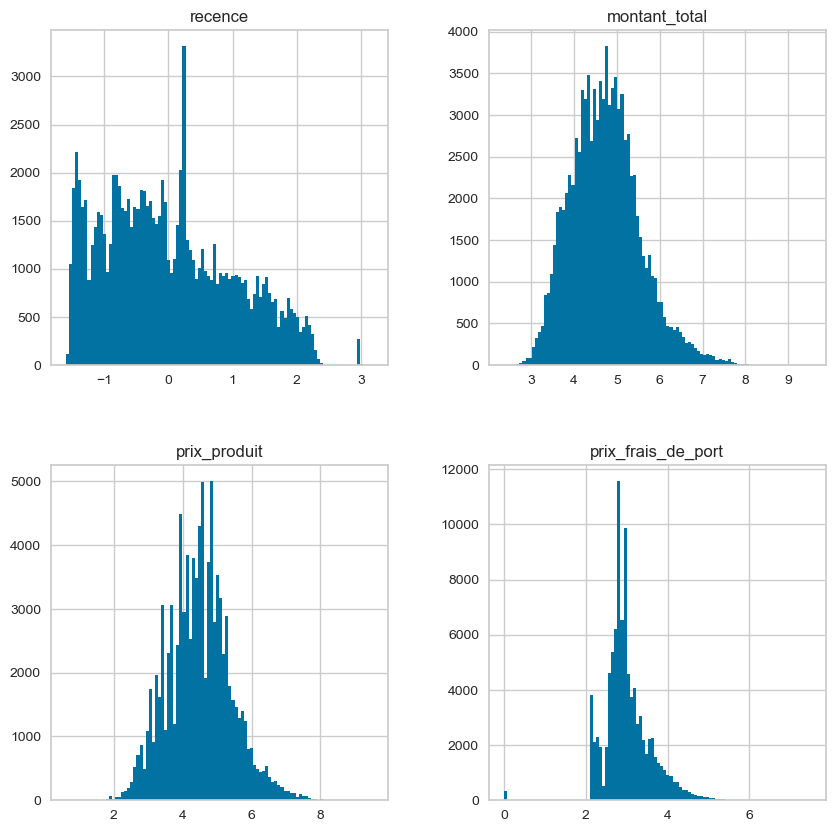

In [27]:
X_t2.hist(figsize=(10,10), bins=100)
plt.savefig("./Visualisations/Transfo_log", bbox_inches='tight')
plt.show()

#### Création des variable Moyenne produit et moyenne paiement

In [10]:
df.loc[:,'moy_paiement'] = (df.loc[:,'nombre_paiement']/df.loc[:,'nombre_commande'])
df.loc[:,'moy_produit'] = (df.loc[:,'nombre_produit']/df.loc[:,'nombre_commande'])

In [11]:
df.describe()

,code_postal,nombre_commande,nombre_paiement,montant_total,note,nombre_produit,prix_produit,prix_frais_de_port,recence,moy_paiement,moy_produit
count,94989.000000,94989.000000,94989.000000,94989.000000,94989.000000,94989.000000,94989.000000,94989.000000,94989.000000,94989.000000,94989.000000
mean,35242.167251,1.033867,3.082336,165.694312,4.104823,1.180200,142.068865,23.595181,270.344493,2.967929,1.138868
std,29810.584088,0.210828,2.965391,226.740844,1.315007,0.620553,216.069013,22.866916,152.993593,2.718703,0.525765
min,1003.000000,1.000000,1.000000,9.590000,1.000000,1.000000,0.850000,0.000000,27.000000,1.000000,1.000000
25%,11432.000000,1.000000,1.000000,63.100000,4.000000,1.000000,47.900000,14.090000,146.000000,1.000000,1.000000
50%,24457.000000,1.000000,2.000000,107.900000,5.000000,1.000000,89.890000,17.600000,251.000000,2.000000,1.000000
75%,59069.000000,1.000000,4.000000,182.940000,5.000000,1.000000,155.000000,25.540000,379.000000,4.000000,1.000000
max,99990.000000,16.000000,64.000000,13664.080000,5.000000,24.000000,13440.000000,1794.960000,756.000000,29.000000,21.000000


In [12]:
df.loc[df['moy_paiement']==0]

,id_client,code_postal,ville,region,nombre_commande,date_dernier_achat,nombre_paiement,montant_total,note,nombre_produit,prix_produit,prix_frais_de_port,categorie,recence,groupe,moy_paiement,moy_produit


## Comparaison et test des modèles

Test des modèles:
- K-means
- Agglomerative Clustering (Clustering hiérarchique)
- DBScan

Un échantillon de 50% de la population choisi aléatoirement sera utilisé , car il y a une limite de la machine, le même échantillon sera utilisé pour les 3 modèles

In [82]:
#Transformations 
X = df[['recence','nombre_commande', 'montant_total']]
X_s = pd.DataFrame(columns=['recence','nombre_commande', 'montant_total'])
X_s['recence'] = preprocessing.scale(X['recence'])
X_s['nombre_commande'] = X['nombre_commande']
X_s[ 'montant_total'] = np.log1p(X[ 'montant_total'])

#Split du dataset
X_split1,X_split2 = model_selection.train_test_split(X_s, shuffle=True, train_size=0.5)

### Clustering KMeans
Minimise l'inertie, soit la variance intra-cluster

- Utilisation de la technique du coude et du silhouette score pour définir le bon nombre de cluster
- Visualisation des clusters et la répartitions des individus dans les clusters (avec le bon nombre de cluster)

In [83]:
# Stockage de l'inertie et du silhouette score pour chaque cas de clusters variant de 2 à 12 clusters
inertia =[]
silhouette = []
k_range = range(2,12)

for k in k_range:
    cls = cluster.KMeans(n_clusters=k).fit(X_split1)
    inertia.append(cls.inertia_)
    lab = cls.labels_
    score = metrics.silhouette_score(X_split1, lab)
    silhouette.append(score)

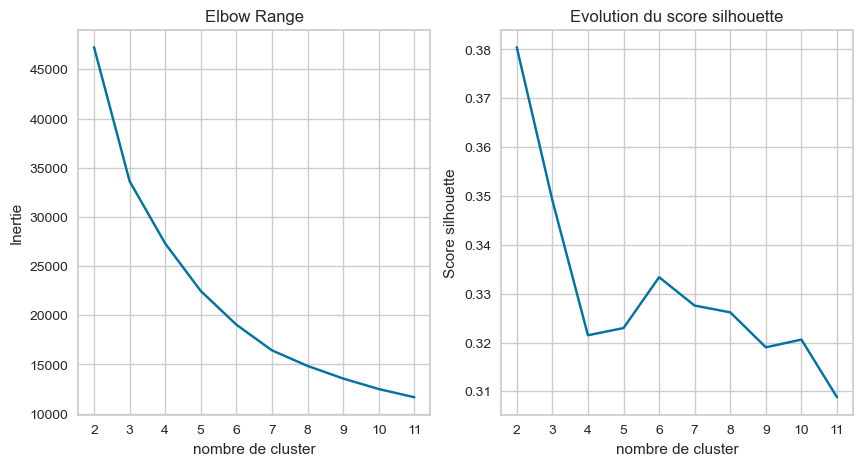

In [84]:
# Visualisation de l'Elbow range
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.plot(k_range, inertia)
plt.xticks(range(2,12))
plt.xlabel("nombre de cluster")
plt.ylabel("Inertie")
plt.title("Elbow Range")
#Visualisation de l'évolution du score silhouette
plt.subplot(1,2,2)
plt.plot(k_range, silhouette)
plt.xticks(range(2,12))
plt.xlabel("nombre de cluster")
plt.ylabel("Score silhouette")
plt.title("Evolution du score silhouette")
plt.savefig("./Visualisations/K_means_split", bbox_inches='tight')
plt.show()

In [85]:
# Choix d'apres les graphes k=3
cls_km = cluster.KMeans(n_clusters=3).fit(X_split1)
lab_km = cls_km.labels_
centers_km = cls_km.cluster_centers_

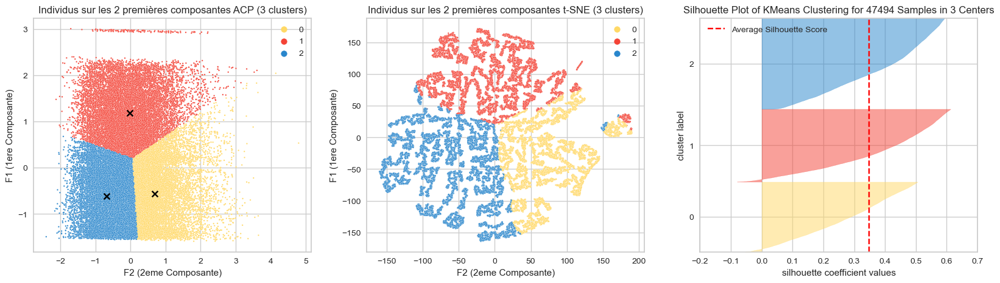

<Figure size 800x550 with 0 Axes>

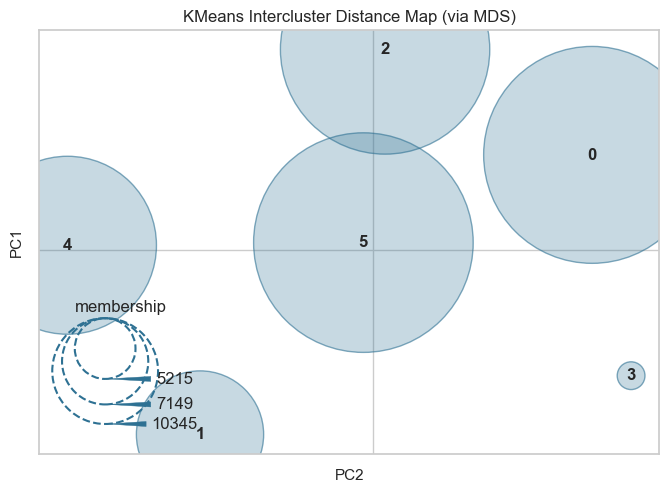

<Figure size 800x550 with 0 Axes>

In [86]:
#ACP
X_split_p = pca.fit_transform(X_split1)
centro =pca.fit_transform(centers_km)
colors=['#ffd966', '#f44336', '#2986cc', '#00FF00', '#FF00FF', '#ff7f00']

# t-SNE
tsne = manifold.TSNE(n_components=2, perplexity=50, n_iter=5000, init='pca', n_jobs = -1)
tsne_split = tsne.fit_transform(X_split1)


plt.figure(figsize=(20,5))
#Visualisation sur les composantes ACP
plt.subplot(1,3,1)
sns.scatterplot(x=  X_split_p[:,1], y= X_split_p[:,0], hue=lab_km, palette=colors, s=3)
plt.scatter(y=centro[:,0], x=centro[:,1], c='#000000', marker='x')
plt.xlabel("F2 (2eme Composante)")
plt.ylabel("F1 (1ere Composante)")
plt.title("Individus sur les 2 premières composantes ACP (3 clusters)")
#Visualisation Silhouette plot
plt.subplot(1,3,2)
sns.scatterplot( x=  tsne_split[:,1], y= tsne_split[:,0], hue=lab_km, palette=colors, s=3)
plt.xlabel("F2 (2eme Composante)")
plt.ylabel("F1 (1ere Composante)")
plt.title("Individus sur les 2 premières composantes t-SNE (3 clusters)")
plt.subplot(1,3,3)
visualizer = SilhouetteVisualizer(cls_km, colors=colors)
visualizer.fit(X_split1)
visualizer.show()
plt.savefig("./Visualisations/Visu_K_means_3_Split", bbox_inches='tight')
plt.show()

distance= InterclusterDistance(cls_km).fit(X_split1)
distance.show()
plt.savefig("./Visualisations/Visu_Inter_K_means_3_Split", bbox_inches='tight' )
plt.show()

#### Visualisation pour 6 clusters

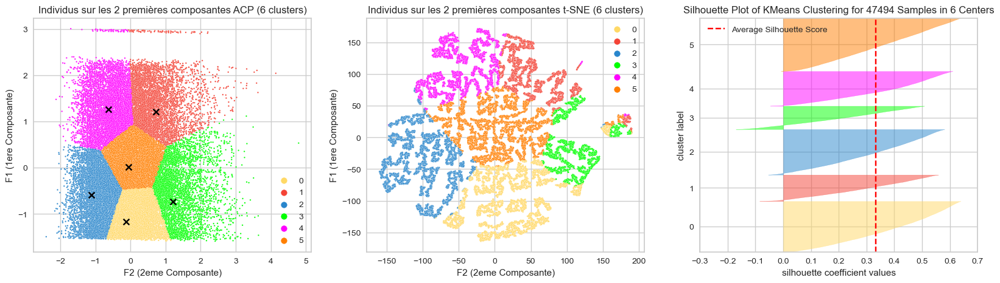

<Figure size 800x550 with 0 Axes>

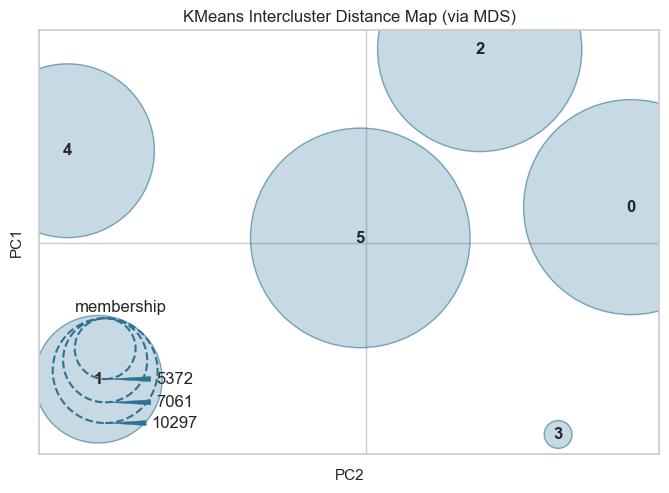

<Figure size 800x550 with 0 Axes>

In [87]:
cls_km2 = cluster.KMeans(n_clusters=6).fit(X_split1)
lab_km2 = cls_km2.labels_
centers_km2 = cls_km2.cluster_centers_

centro_km =pca.fit_transform(centers_km2)

plt.figure(figsize=(20,5))
#Visualisation sur les composantes ACP
plt.subplot(1,3,1)
sns.scatterplot(x=  X_split_p[:,1], y= X_split_p[:,0], hue=lab_km2, palette=colors, s=3)
plt.scatter(y=centro_km[:,0], x=centro_km[:,1], c='#000000', marker='x')
plt.xlabel("F2 (2eme Composante)")
plt.ylabel("F1 (1ere Composante)")
plt.title("Individus sur les 2 premières composantes ACP (6 clusters)")
#Visualisation sur les composantes t-SNE
plt.subplot(1,3,2)
sns.scatterplot(x=  tsne_split[:,1], y= tsne_split[:,0], hue=lab_km2, palette=colors, s=3)
plt.xlabel("F2 (2eme Composante)")
plt.ylabel("F1 (1ere Composante)")
plt.title("Individus sur les 2 premières composantes t-SNE (6 clusters)")
#Visualisation Silhouette plot
plt.subplot(1,3,3)
visualizer = SilhouetteVisualizer(cls_km2, colors=colors)
visualizer.fit(X_split1)
visualizer.show()
plt.savefig("./Visualisations/Visu_K_means_6_Split", bbox_inches='tight')
plt.show()

distance= InterclusterDistance(cls_km2).fit(X_split1)
distance.show()
plt.savefig("./Visualisations/Visu_Inter_K_means_6_Split", bbox_inches='tight' )
plt.show()

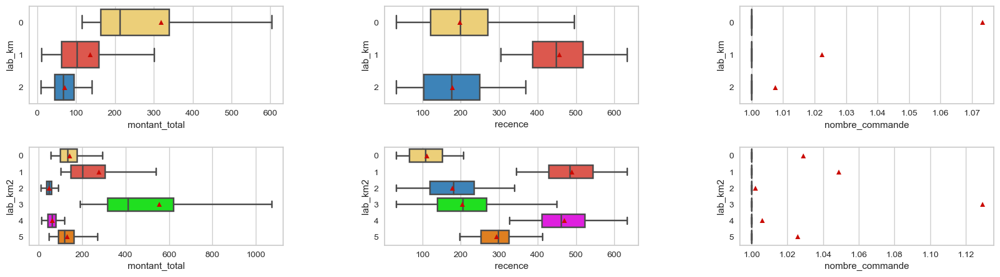

In [88]:
X_modif = X_split1
X_v = X.loc[X_split1.index]

X_modif.loc[:,'lab_km'] = lab_km.astype(str)
X_modif.loc[:,'lab_km2'] = lab_km2.astype(str)
plt.figure(figsize=(20,5))
# Avec les 3 Clusters
plt.subplot(2,3,1)
sns.boxplot(data =  X_v, x = 'montant_total', y= X_modif['lab_km'],  order=['0','1','2'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(2,3,2)
sns.boxplot(data =  X_v, x = 'recence', y= X_modif['lab_km'],  order=['0','1','2'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(2,3,3)
sns.boxplot(data =  X_v, x = 'nombre_commande', y= X_modif['lab_km'],  order=['0','1','2'], showfliers=False,showmeans=True, palette=colors)
# Avec les 6 Clusters
plt.subplot(2,3,4)
sns.boxplot(data =  X_v, x = 'montant_total', y= X_modif['lab_km2'],  order=['0','1','2','3','4','5'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(2,3,5)
sns.boxplot(data =  X_v, x = 'recence', y= X_modif['lab_km2'],  order=['0','1','2','3','4','5'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(2,3,6)
sns.boxplot(data =  X_split1, x = 'nombre_commande', y= X_modif['lab_km2'],  order=['0','1','2','3','4','5'], showfliers=False,showmeans=True, palette=colors)
plt.subplots_adjust(hspace=0.45,wspace=0.40)
plt.savefig("./Visualisations/Boxplot_K_means_Split", bbox_inches='tight')
plt.show()

### Clustering hiérachique
Chaque observation est un cluster puis on les regroupe successivement en minimisant la variance intra-cluster, la méthode utilisée sera la méthode de Ward

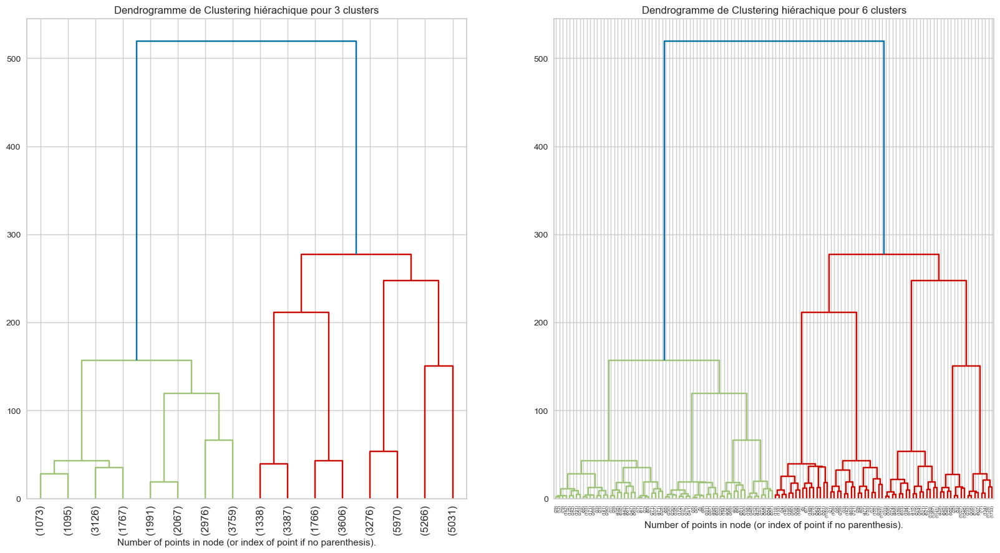

In [89]:
def plot_dendrogram(model, **kwargs):

    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    sp.cluster.hierarchy.dendrogram(linkage_matrix, **kwargs)

cls = cluster.AgglomerativeClustering(distance_threshold=0, n_clusters=None)

cls = cls.fit(X_split1)

# Les 3 meilleurs niveaux du dendrogramme
plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
plot_dendrogram(cls, truncate_mode="level", p=3)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.xticks(rotation=90)
plt.title("Dendrogramme de Clustering hiérachique pour 3 clusters")
plt.subplot(1,2,2)
plot_dendrogram(cls, truncate_mode="level", p=6)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.xticks(rotation=90)
plt.title("Dendrogramme de Clustering hiérachique pour 6 clusters")
plt.savefig("./Visualisations/Visu_dendo_Split", bbox_inches='tight')
plt.show()

In [90]:
cls_hc = cluster.AgglomerativeClustering(n_clusters=3)
cls_hc = cls_hc.fit(X_split1)
lab_hc = cls_hc.labels_
lab_hc.shape

(47494,)

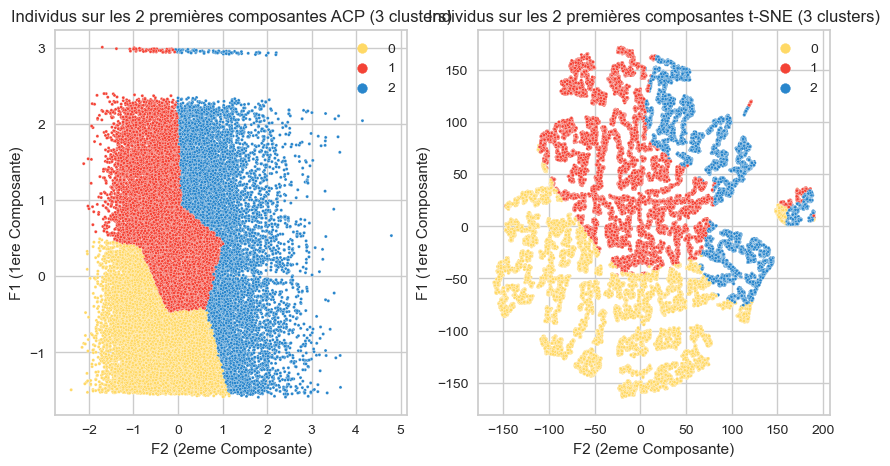

In [91]:
plt.figure(figsize=(10,5))
#Visualisation sur les composantes ACP
plt.subplot(1,2,1)
sns.scatterplot(x=  X_split_p[:,1], y= X_split_p[:,0], hue=lab_hc, palette=colors, s=5)
plt.xlabel("F2 (2eme Composante)")
plt.ylabel("F1 (1ere Composante)")
plt.title("Individus sur les 2 premières composantes ACP (3 clusters)")
#Visualisation sur les composante t-SNE
plt.subplot(1,2,2)
sns.scatterplot( x=  tsne_split[:,1], y= tsne_split[:,0], hue=lab_hc, palette=colors, s=5)
plt.xlabel("F2 (2eme Composante)")
plt.ylabel("F1 (1ere Composante)")
plt.title("Individus sur les 2 premières composantes t-SNE (3 clusters)")
plt.savefig("./Visualisations/Visu_HC_3_Split", bbox_inches='tight')
plt.show()

In [92]:
cls_hc2 = cluster.AgglomerativeClustering(n_clusters=6)
cls_hc2 = cls_hc2.fit(X_split1)
lab_hc2 = cls_hc2.labels_

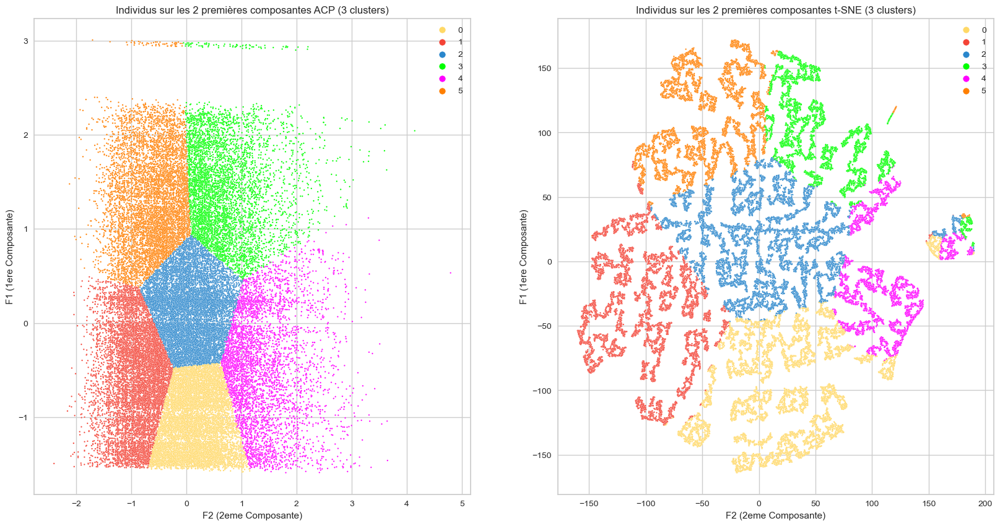

In [93]:
plt.figure(figsize=(20,10))
#Visualisation sur les composantes ACP
plt.subplot(1,2,1)
sns.scatterplot(x=  X_split_p[:,1], y= X_split_p[:,0], hue=lab_hc2, palette=colors, s=3)
plt.xlabel("F2 (2eme Composante)")
plt.ylabel("F1 (1ere Composante)")
plt.title("Individus sur les 2 premières composantes ACP (3 clusters)")
#Visualisation sur les composante t-SNE
plt.subplot(1,2,2)
sns.scatterplot( x=  tsne_split[:,1], y= tsne_split[:,0], hue=lab_hc2, palette=colors, s=3)
plt.xlabel("F2 (2eme Composante)")
plt.ylabel("F1 (1ere Composante)")
plt.title("Individus sur les 2 premières composantes t-SNE (3 clusters)")
plt.savefig("./Visualisations/Visu_HC_6_Split", bbox_inches='tight')
plt.show()

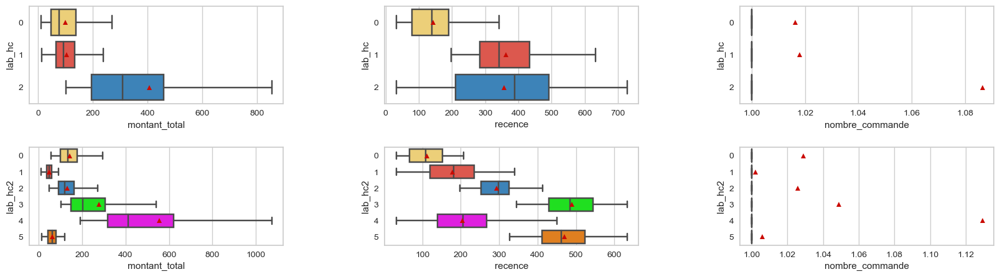

In [94]:
X_modif.loc[:,'lab_hc'] = lab_hc.astype(str)
X_modif.loc[:,'lab_hc2'] = lab_hc2.astype(str)
plt.figure(figsize=(20,5))
# Avec les 3 Clusters
plt.subplot(2,3,1)
sns.boxplot(data =  X_v, x = 'montant_total', y= X_modif['lab_hc'],  order=['0','1','2'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(2,3,2)
sns.boxplot(data =  X_v, x = 'recence', y= X_modif['lab_hc'],  order=['0','1','2'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(2,3,3)
sns.boxplot(data =  X_v, x = 'nombre_commande', y= X_modif['lab_hc'],  order=['0','1','2'], showfliers=False,showmeans=True, palette=colors)
# Avec les 6 Clusters
plt.subplot(2,3,4)
sns.boxplot(data =  X_v, x = 'montant_total', y= X_modif['lab_hc2'],  order=['0','1','2','3','4','5'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(2,3,5)
sns.boxplot(data =  X_v, x = 'recence', y= X_modif['lab_hc2'],  order=['0','1','2','3','4','5'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(2,3,6)
sns.boxplot(data =  X_v, x = 'nombre_commande', y= X_modif['lab_hc2'],  order=['0','1','2','3','4','5'], showfliers=False,showmeans=True, palette=colors)
plt.subplots_adjust(hspace=0.45,wspace=0.40)
plt.savefig("./Visualisations/Boxplot_HC_Split", bbox_inches='tight')
plt.show()

#### Comparaison ARI

In [301]:
metrics.adjusted_rand_score(lab_km, lab_hc)

0.28256891507080206

In [302]:
metrics.adjusted_rand_score(lab_km2, lab_hc2)

1.0

### DBSCAN
Relie les points d'un même cluster en passant de voisins en voisins

In [95]:
X_s = pd.DataFrame(columns=['recence','nombre_commande', 'montant_total'])
X_s['recence'] = preprocessing.scale(X['recence'])
X_s['nombre_commande'] = X['nombre_commande']
X_s[ 'montant_total'] = np.log1p(X[ 'montant_total'])
X_split1,X_split2 = model_selection.train_test_split(X_s, shuffle=True, train_size=0.5)

In [96]:
from sklearn.cluster import DBSCAN

clustering = DBSCAN(eps=3, min_samples=2).fit(X_split1)
lab_db = clustering.labels_

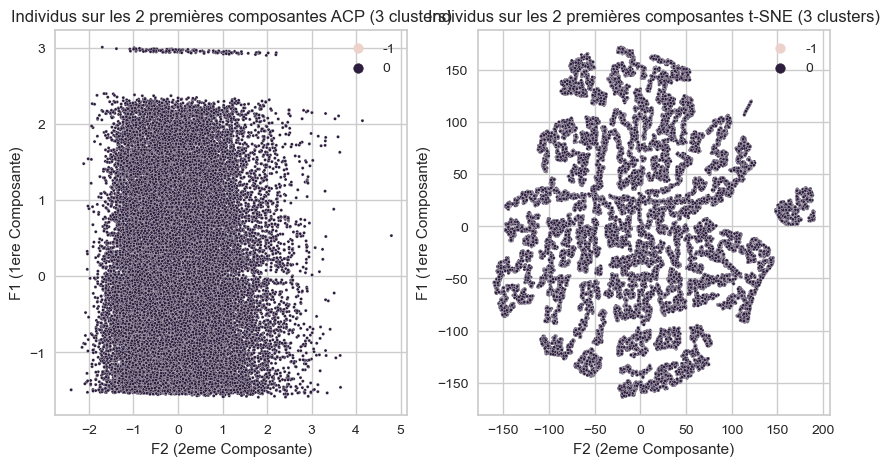

In [97]:
plt.figure(figsize=(10,5))
#Visualisation sur les composantes ACP
plt.subplot(1,2,1)
sns.scatterplot(x=  X_split_p[:,1], y= X_split_p[:,0], hue=lab_db, s=5)
plt.xlabel("F2 (2eme Composante)")
plt.ylabel("F1 (1ere Composante)")
plt.title("Individus sur les 2 premières composantes ACP (3 clusters)")
#Visualisation sur les composante t-SNE
plt.subplot(1,2,2)
sns.scatterplot( x=  tsne_split[:,1], y= tsne_split[:,0], hue=lab_db, s=5)
plt.xlabel("F2 (2eme Composante)")
plt.ylabel("F1 (1ere Composante)")
plt.title("Individus sur les 2 premières composantes t-SNE (3 clusters)")
plt.show()

## Modele K-means ajout de variable

- Ajout un à un des variables
- Visualisation de l'evolution de l'inertie et du score silhouette en fonction du nombre de clusters
- Choix du nombre de clusters le plus adapté et si trop généraliste visualisation d'un autre choix
- Visualisation des indivus sur 2 dimensions (ACP pas adapté mais visualisation par curiosité) et des silhouette plots
- Visualisation de la stabilité via l'ARI sur 25 répétitions

### Fonctions utilisées

In [13]:
def elbow_shilhouette(X, k_range):
    #Fonction qui réalise le pré-traitement des données, visualise l'évolution de l'inertie en fonction du nombre de clusters
    #ainsi que l'évolution du score silhouette moyen en fonction du nombre de clusters
    
    #Partitions des transformations
    quant = ['recence']
    mont = ['montant_total']
    qual = X.select_dtypes(include =['object']).columns
    
    #Transformations et Encodage
    scaler = preprocessing.StandardScaler()
    log = preprocessing.FunctionTransformer(np.log1p)
    encoder = preprocessing.OneHotEncoder(handle_unknown = 'ignore') 


    #Transformation de colonnes
    preprocessor = ColumnTransformer(transformers=[("quant", scaler, quant),
                                                   ("qual", encoder, qual), 
                                                   ('mont', log, mont)],
                                     remainder='passthrough')
    
    #Listes pour stockage
    inertia =[]
    silhouette = []

    for k in k_range:
        cls = cluster.KMeans(n_clusters=k)
        pipeline_mod = Pipeline([("preprocessor", preprocessor), 
                                 ("model", cls)]).fit(X)
        #Ajout de l'inertie
        inertia.append(pipeline_mod.named_steps['model'].inertia_)#Inertie des clusters
        lab = pipeline_mod.named_steps['model'].labels_ #Labels des clusters
        centers = pipeline_mod.named_steps['model'].cluster_centers_ #Centroides des clusters
        score = metrics.silhouette_score(preprocessor.fit_transform(X), lab) #Score silhouette
        #Ajout du score silhouette
        silhouette.append(score)
        
    # Visualisation de l'Elbow range
    plt.figure(figsize=(10,5))
    plt.subplot(1,2,1)
    plt.plot(k_range, inertia)
    plt.xticks(k_range)
    plt.xlabel("nombre de cluster")
    plt.ylabel("Inertie")
    plt.title("Elbow Range")
    #Visualisation de l'évolution du score silhouette
    plt.subplot(1,2,2)
    plt.plot(k_range, silhouette)
    plt.xticks(k_range)
    plt.xlabel("nombre de cluster")
    plt.ylabel("Score silhouette")
    plt.title("Evolution du score silhouette")
    plt.savefig("./Visualisations/Elbow_Silhouette_df_{}".format(X.name), bbox_inches='tight' )
    plt.show()

In [28]:
def cls_viz(X,k_list):
    # Fonction pour visualiser les individus sur 2 dimensions (ACP peu adapté et t-SNE recommandé)
    #ainsi que la stabilité du modèle via l'évolution de l'ARI sur 25 répétitions
    
    #Partitions des transformations
    quant = ['recence']
    mont = ['montant_total']
    qual = X.select_dtypes(include =['object']).columns
    
    #Transformations et Encodage
    scaler = preprocessing.StandardScaler()
    log = preprocessing.FunctionTransformer(np.log1p)
    encoder = preprocessing.OneHotEncoder(handle_unknown = 'ignore') 


    #Transformation de colonnes
    preprocessor = ColumnTransformer(transformers=[("quant", scaler, quant),
                                                   ("qual", encoder, qual), 
                                                   ('mont', log, mont)],
                                     remainder='passthrough')
        
    #ACP
    pca = PCA(n_components=2)
    X_proj = pca.fit_transform(preprocessor.fit_transform(X))
    
    
    #t-SNE
    t_sne = manifold.TSNE(n_components=2, perplexity=50, n_iter=5000, init='pca', n_jobs = -1)
    t_sne = Pipeline([("preprocessor", preprocessor), 
                      ("model", t_sne)]).fit_transform(X)
    
    colors = ["#f44336", "#2986cc", "#ffd966", "#8fce00", "#6a00ce", "#FF9800"] 
    #Rouge, Bleu, Jaune, Vert, Violet, Orange
    X2 = X.copy()
    
    for k in k_list:
        
        #Modèle
        cls = cluster.KMeans(n_clusters=k)
        pipeline_mod = Pipeline([("preprocessor", preprocessor), 
                                 ("model", cls)]).fit(X)
        lab = pipeline_mod.named_steps['model'].labels_ #Labels des clusters
        centers = pipeline_mod.named_steps['model'].cluster_centers_ #Centroides des clusters
        
        #Ajout de colonne
        X2.loc[:,'{}_clusters'.format(k)] = lab
        
        plt.figure(figsize=(15,5))
        #Visualisation sur les composantes ACP
        plt.subplot(1,2,1)
        sns.scatterplot(x=  X_proj[:,1], y= X_proj[:,0], hue=lab, palette=colors, s=3)
        plt.xlabel("F2 (2eme Composante)")
        plt.ylabel("F1 (1ere Composante)")
        plt.title("Individus sur les 2 premières composantes ACP ( {} clusters)".format(k))
        #Visualisation sur les composantes ACP
        plt.subplot(1,2,2)
        sns.scatterplot( x=  t_sne[:,1], y= t_sne[:,0], hue=lab, palette=colors, s=3)
        plt.xlabel("F2 (2eme Composante)")
        plt.ylabel("F1 (1ere Composante)")
        plt.title("Individus sur les 2 premières composantes t-SNE ( {} clusters)".format(k))
        plt.savefig("./Visualisations/Visu_df_{}_pour_{}_ clusters".format(X.name, k), bbox_inches='tight' )
        plt.show()
        
        #Visualisation Silhouette plot
        plt.figure(figsize=(15,5))
        plt.subplot(1,2,1)
        visualizer = SilhouetteVisualizer(cls, colors=colors).fit(preprocessor.fit_transform(X))
        visualizer.show(outpath="./Visualisations/Silhouette_Plot_df_{}_pour_{}_ clusters.png".format(X.name, k))
        plt.subplot(1,2,2)
        distance= InterclusterDistance(cls).fit(preprocessor.fit_transform(X))
        distance.show(outpath="./Visualisations/Inter_Clusters_df_{}_pour_{}_ clusters.png".format(X.name, k))
        plt.show
    
    
        #Liste pour stockage
        ari = []
    
        for n in range(25):
            cls_2= cluster.KMeans(n_clusters=k)
            pipeline_mod = Pipeline([("preprocessor", preprocessor), 
                             ("model", cls_2)]).fit(X)
            lab2 = pipeline_mod.named_steps['model'].labels_
            a = metrics.adjusted_rand_score(lab, lab2)
            ari.append(a)
    
        # ARI minimum et ARI moyen
        ari_mean = round(np.mean(ari),2)
        ari_min = round(min(ari),2)
    
        # Visualisation de l'évolution de l'ARI
        plt.figure(figsize=(10,5))
        plt.plot(range(25), ari)
        plt.xticks(range(25))
        plt.xlabel("Nombre de répétitions")
        plt.ylabel("ARI")
        plt.title("Evolution de l'ARI pour {} clusters".format(k))
        plt.text(0,ari_min,s = 'ARI Min = {}\nARI Moy={}'.format(ari_min, ari_mean))
        plt.savefig("./Visualisations/ARI_df_{}_pour_{}_ clusters".format(X.name, k), bbox_inches='tight' )
        plt.show()
    
    return X2, X_proj, t_sne

#### Palette utilisée

In [29]:
colors = ["#f44336", "#2986cc", "#ffd966", "#8fce00", "#6a00ce", "#FF9800"]
k_range = range(2,12)

### Ajout de la variable note

In [30]:
X2 = df[['recence','nombre_commande', 'montant_total','note']]
X2.name='avec_ajout_note' #Nom du dataframme

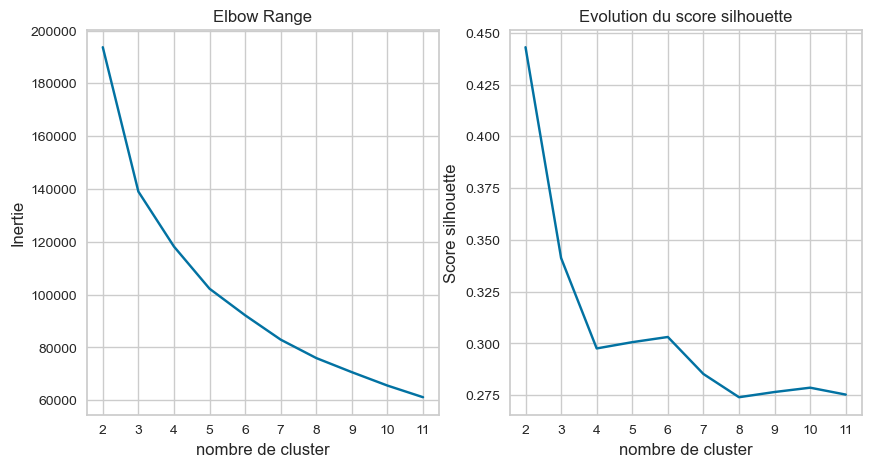

In [31]:
# Définir le choix du nombre de cluster
elbow_shilhouette(X2, k_range)

#### Visualisation pour 3 clusters et 5 clusters

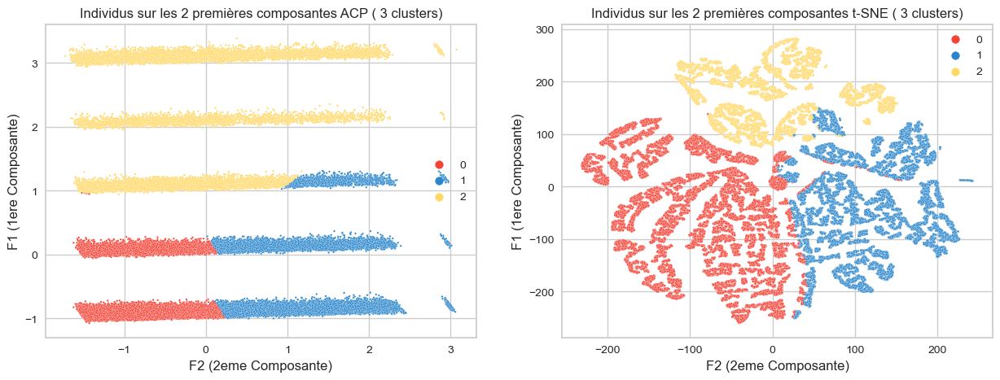

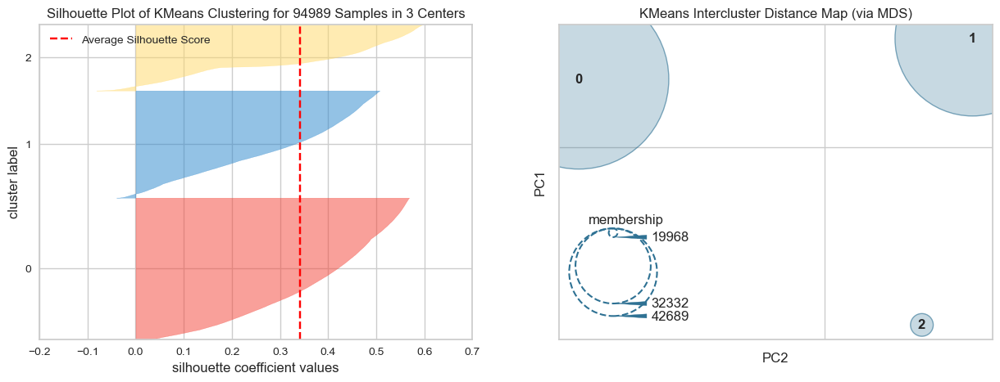

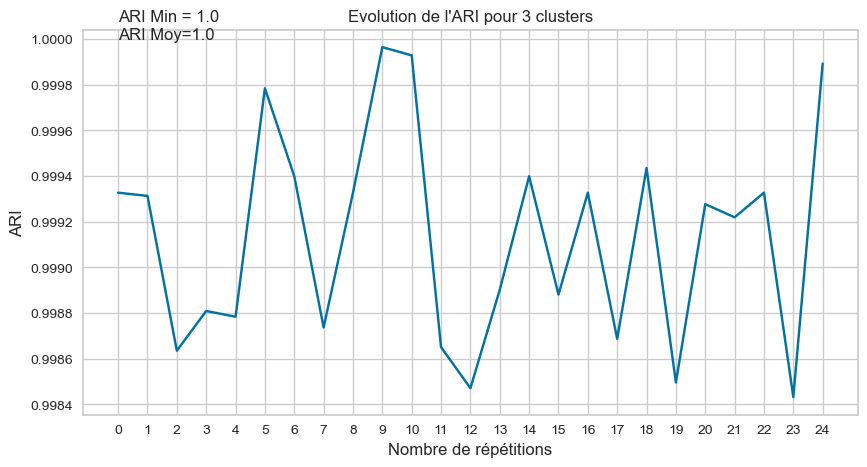

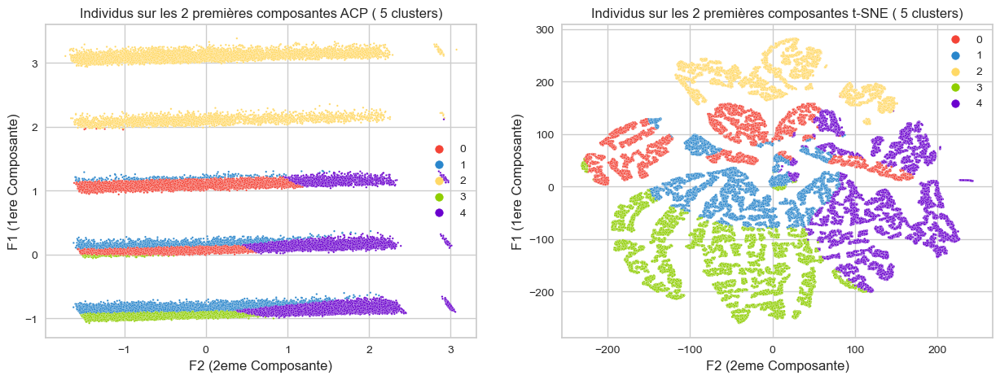

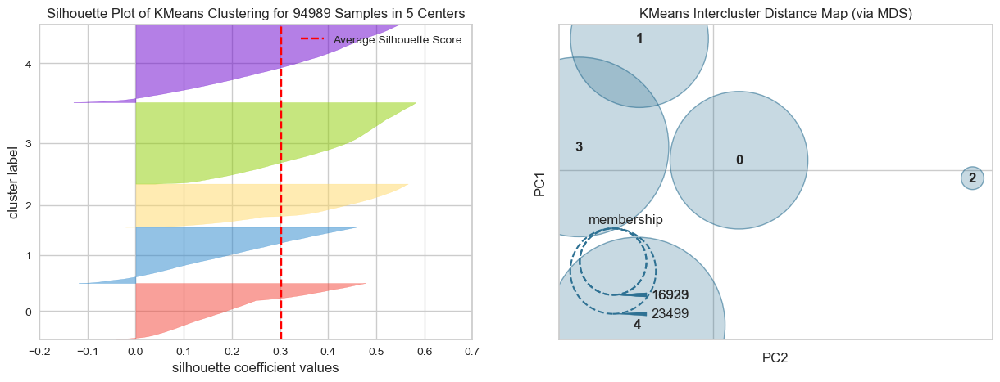

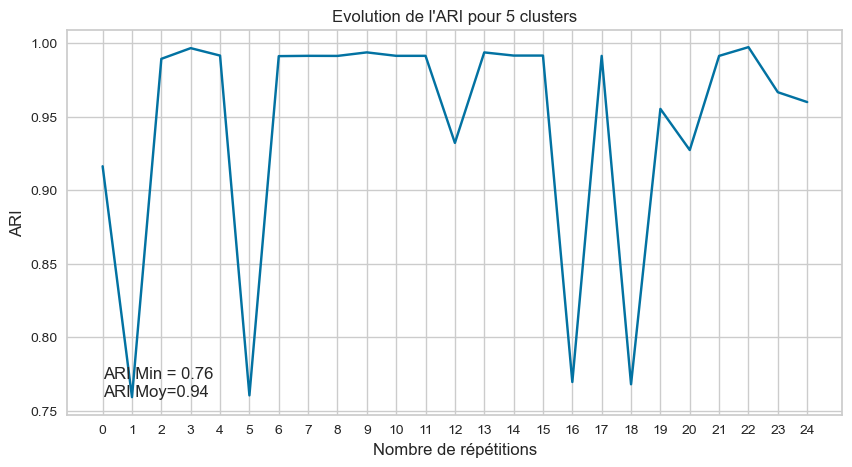

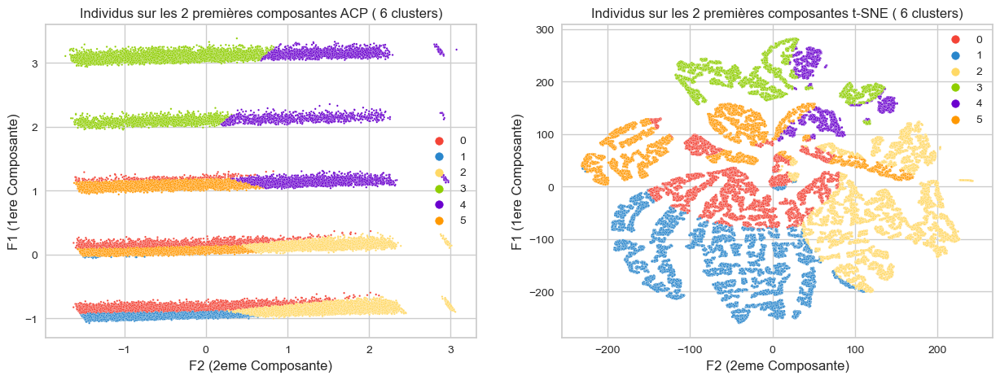

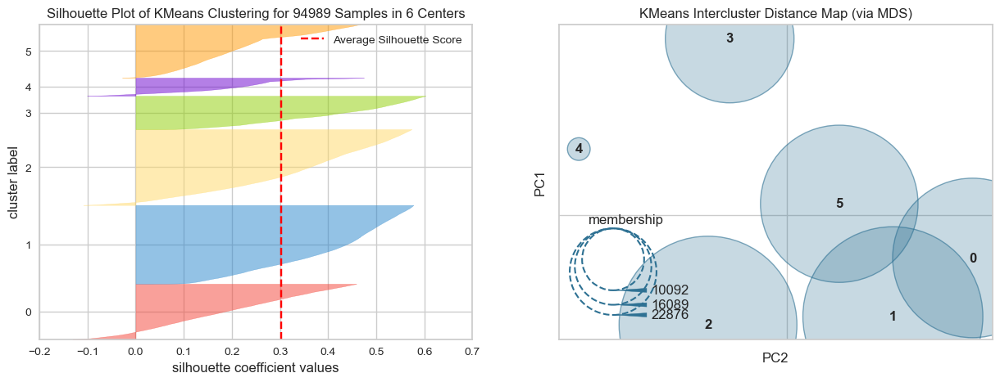

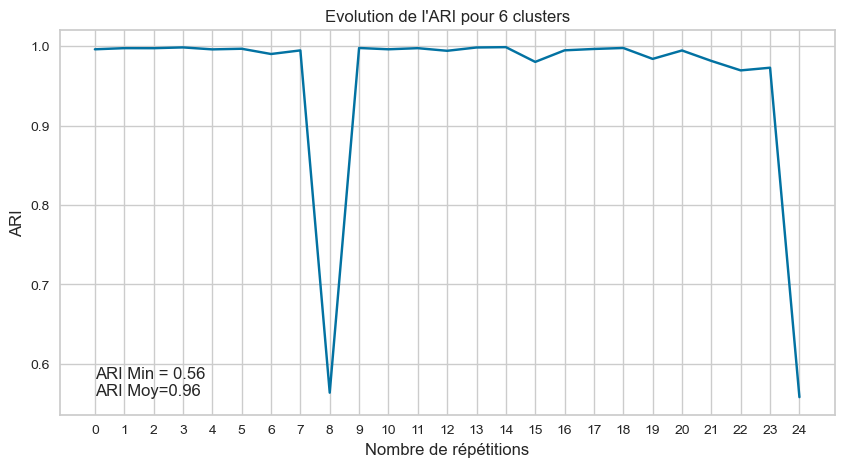

In [32]:
X2_lab, acp_X2, tsne_X2 = cls_viz(X2, [3,5,6])

#### Visualisation répartitions

In [33]:
X2_lab[['3_clusters','5_clusters','6_clusters']] = X2_lab[['3_clusters','5_clusters','6_clusters']].astype('str')

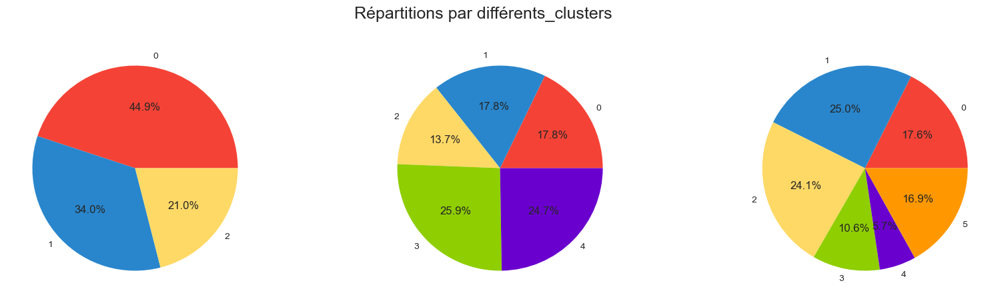

In [34]:
plt.figure(figsize=(20,5))
plt.subplot(1,3,1)
X2_3 = X2_lab['3_clusters'].value_counts()
X2_3 = X2_3.sort_index(ascending=True)
plt.pie(X2_3, labels= X2_3.index, autopct='%1.1f%%',colors=colors)
plt.subplot(1,3,2)
X2_5 = X2_lab['5_clusters'].value_counts()
X2_5 = X2_5.sort_index(ascending=True)
plt.pie(X2_5, labels= X2_5.index, autopct='%1.1f%%',colors=colors)
plt.subplot(1,3,3)
X2_6 = X2_lab['6_clusters'].value_counts()
X2_6 = X2_6.sort_index(ascending=True)
plt.pie(X2_6, labels= X2_6.index, autopct='%1.1f%%',colors=colors)
plt.suptitle("Répartitions par différents_clusters", fontsize=18)
plt.savefig("./Visualisations/Repartitions_df_{}_clusters".format(X2.name), bbox_inches='tight')
plt.show()

#### Visualisation distribution

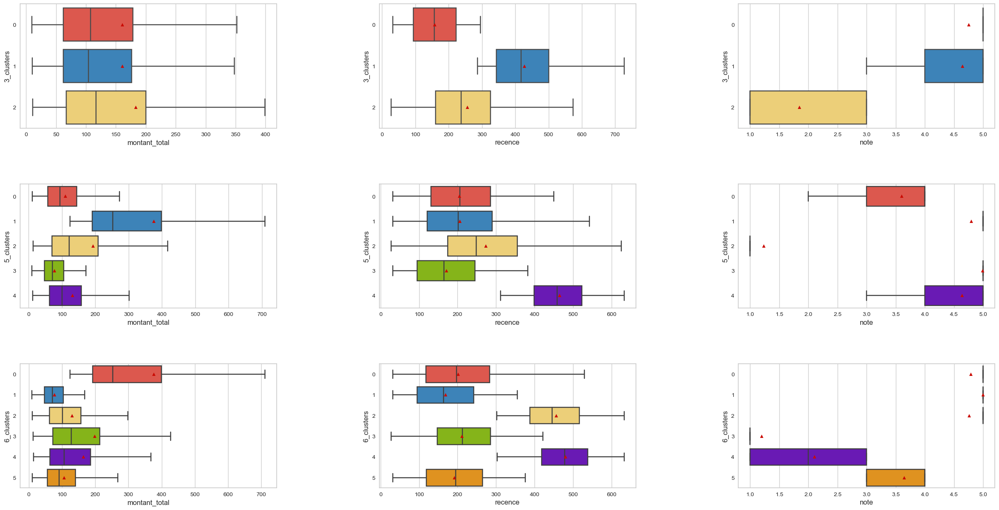

In [35]:
plt.figure(figsize=(30,15))

# Avec les 3 Clusters
plt.subplot(3,3,1)
sns.boxplot(data =  X2_lab, x='montant_total', y= '3_clusters', order=['0','1','2'],  showfliers=False,showmeans=True, palette=colors)
plt.subplot(3,3,2)
sns.boxplot(data =  X2_lab, x='recence', y= '3_clusters',  order=['0','1','2'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(3,3,3)
sns.boxplot(data =  X2_lab, x='note', y= '3_clusters',  order=['0','1','2'], showfliers=False,showmeans=True, palette=colors)

# Avec les 5 Clusters
plt.subplot(3,3,4)
sns.boxplot(data =  X2_lab, x='montant_total', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(3,3,5)
sns.boxplot(data =  X2_lab, x='recence', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(3,3,6)
sns.boxplot(data =  X2_lab, x='note', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)

# Avec les 6 Clusters
plt.subplot(3,3,7)
sns.boxplot(data =  X2_lab, x='montant_total', y= '6_clusters',  order=['0','1','2','3','4','5'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(3,3,8)
sns.boxplot(data =  X2_lab, x='recence', y= '6_clusters',  order=['0','1','2','3','4','5'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(3,3,9)
sns.boxplot(data =  X2_lab, x='note', y= '6_clusters',  order=['0','1','2','3','4','5'], showfliers=False,showmeans=True, palette=colors)

plt.subplots_adjust(hspace=0.45,wspace=0.40)
plt.savefig("./Visualisations/Distributions_df_{}_clusters".format(X2.name), bbox_inches='tight')
plt.show()

### Ajout de la variable nombre de produits

In [36]:
X3 = df[['recence','nombre_commande', 'montant_total','note','moy_produit']]
X3.name='avec_ajout_nombre_produit' #Nom du dataframme

#### Définir le choix du nombre de cluster

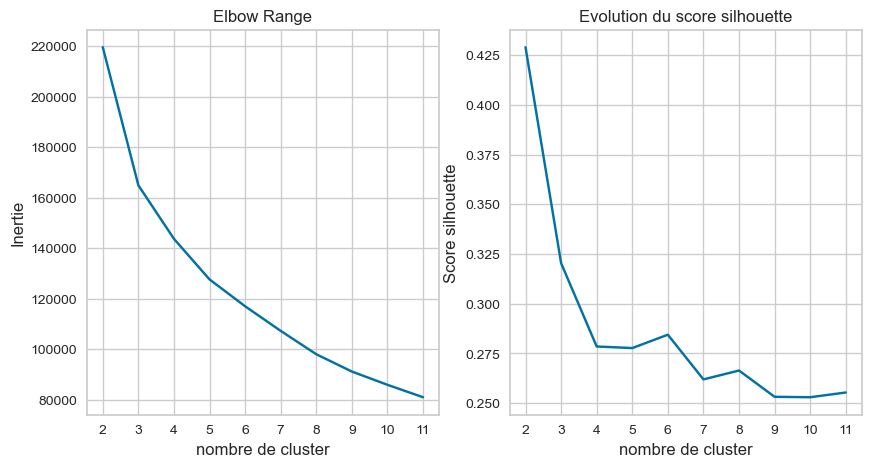

In [37]:
elbow_shilhouette(X3, k_range)

#### Visualisation pour 3 clusters et 5 clusters

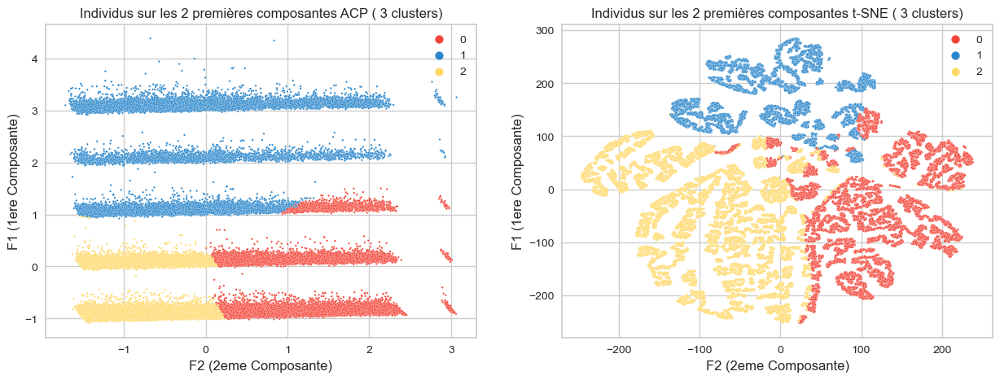

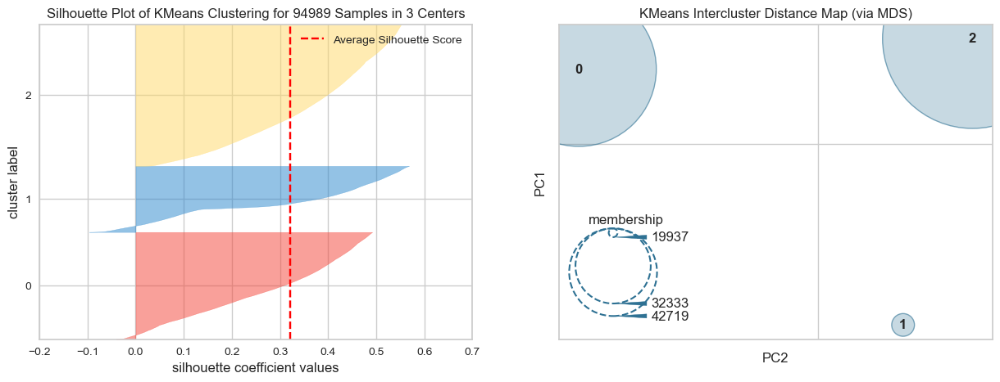

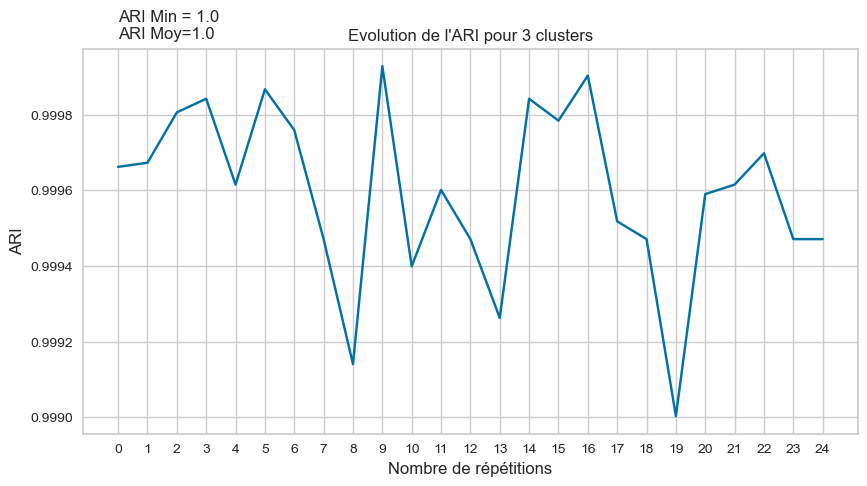

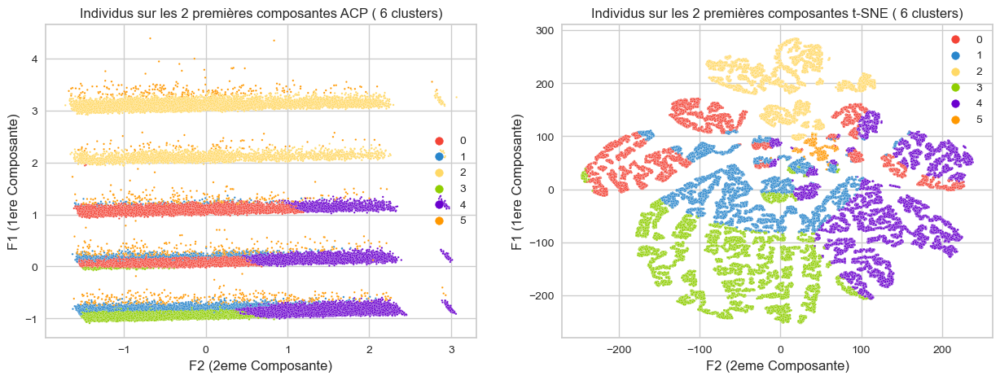

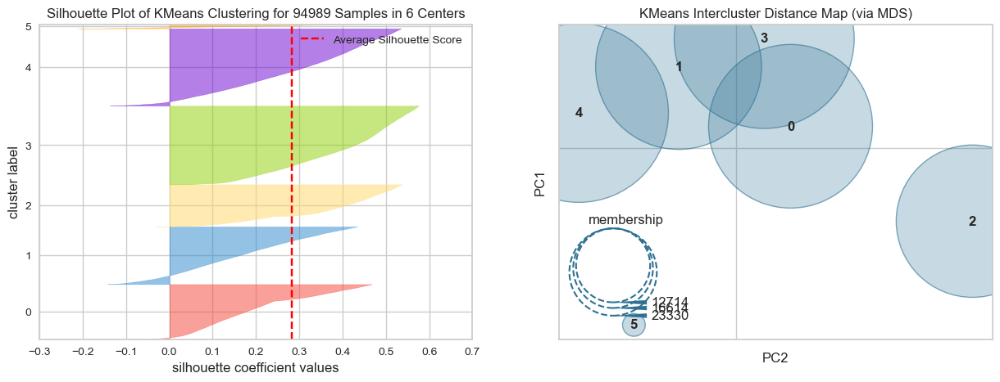

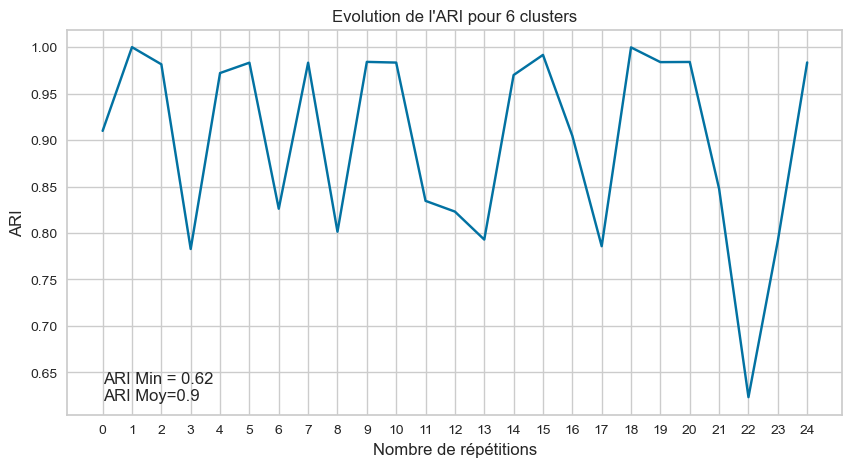

In [40]:
X3_lab, acp_X3, tsne_X3 = cls_viz(X3, [3,6])

#### Visualisation répartitions

In [41]:
X3_lab[['3_clusters','6_clusters']] = X3_lab[['3_clusters','6_clusters']].astype('str')

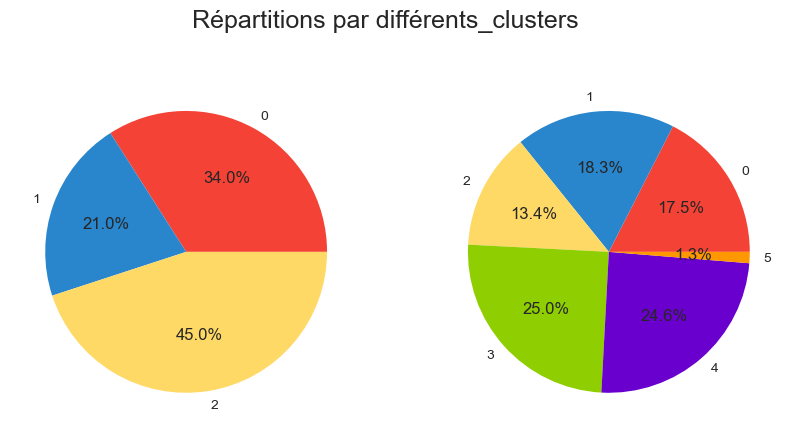

In [42]:
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
X3_3 = X3_lab['3_clusters'].value_counts()
X3_3 = X3_3.sort_index(ascending=True)
plt.pie(X3_3, labels= X3_3.index, autopct='%1.1f%%',colors=colors)
plt.subplot(1,2,2)
X3_6 = X3_lab['6_clusters'].value_counts()
X3_6 = X3_6.sort_index(ascending=True)
plt.pie(X3_6, labels= X3_6.index, autopct='%1.1f%%',colors=colors)
plt.suptitle("Répartitions par différents_clusters", fontsize=18)
plt.savefig("./Visualisations/Repartitions_df_{}_clusters".format(X3.name), bbox_inches='tight')
plt.show()

#### Visualisation distribution

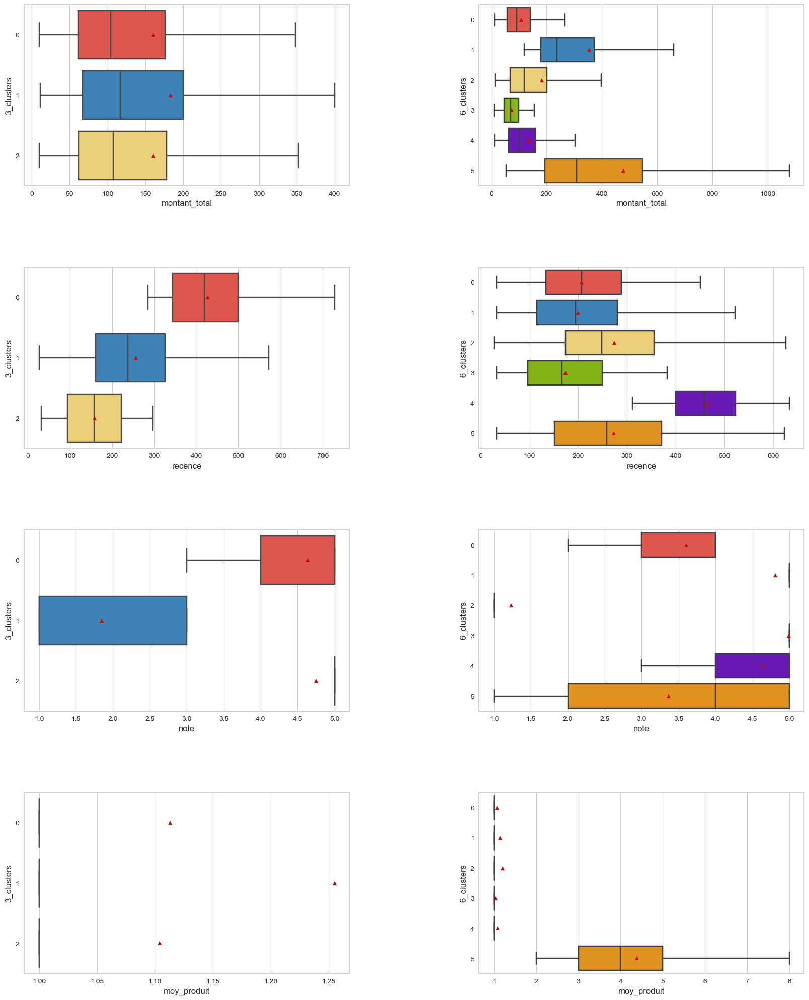

In [45]:
plt.figure(figsize=(20,25))

# Avec les 3 Clusters
plt.subplot(4,2,1)
sns.boxplot(data =  X3_lab, x='montant_total', y= '3_clusters', order=['0','1','2'],  showfliers=False,showmeans=True, palette=colors)
plt.subplot(4,2,3)
sns.boxplot(data =  X3_lab, x='recence', y= '3_clusters',  order=['0','1','2'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(4,2,5)
sns.boxplot(data =  X3_lab, x='note', y= '3_clusters',  order=['0','1','2'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(4,2,7)
sns.boxplot(data =  X3_lab, x='moy_produit', y= '3_clusters',  order=['0','1','2'], showfliers=False,showmeans=True, palette=colors)

# Avec les 5 Clusters
plt.subplot(4,2,2)
sns.boxplot(data =  X3_lab, x='montant_total', y= '6_clusters',  order=['0','1','2','3','4','5'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(4,2,4)
sns.boxplot(data =  X3_lab, x='recence', y= '6_clusters',  order=['0','1','2','3','4','5'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(4,2,6)
sns.boxplot(data =  X3_lab, x='note', y= '6_clusters',  order=['0','1','2','3','4','5'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(4,2,8)
sns.boxplot(data =  X3_lab, x='moy_produit', y= '6_clusters',  order=['0','1','2','3','4','5'], showfliers=False,showmeans=True, palette=colors)

plt.subplots_adjust(hspace=0.45,wspace=0.40)
plt.savefig("./Visualisations/Distributions_df_{}_clusters".format(X3.name), bbox_inches='tight')
plt.show()

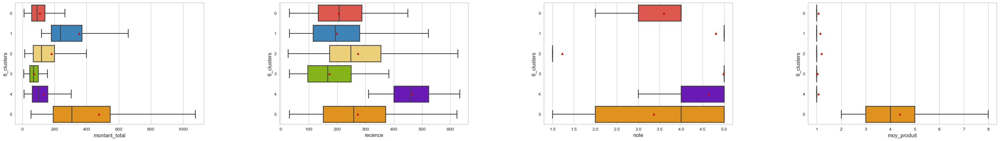

In [59]:
plt.figure(figsize=(40,5))
plt.subplot(1,4,1)
sns.boxplot(data =  X3_lab, x='montant_total', y= '6_clusters',  order=['0','1','2','3','4','5'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(1,4,2)
sns.boxplot(data =  X3_lab, x='recence', y= '6_clusters',  order=['0','1','2','3','4','5'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(1,4,3)
sns.boxplot(data =  X3_lab, x='note', y= '6_clusters',  order=['0','1','2','3','4','5'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(1,4,4)
sns.boxplot(data =  X3_lab, x='moy_produit', y= '6_clusters',  order=['0','1','2','3','4','5'], showfliers=False,showmeans=True, palette=colors)

plt.subplots_adjust(hspace=0.45,wspace=0.40)
plt.savefig("./Visualisations/Distributions_df_{}_pour_5_clusters".format(X3.name), bbox_inches='tight')
plt.show()

### Ajout de la variable moyenne nombre de paiement

In [46]:
X4 = df[['recence','nombre_commande', 'montant_total','note','moy_produit','moy_paiement']]
X4.name='avec_ajout_nombre_paiement' #Nom du dataframme

#### Définir le choix du nombre de cluster

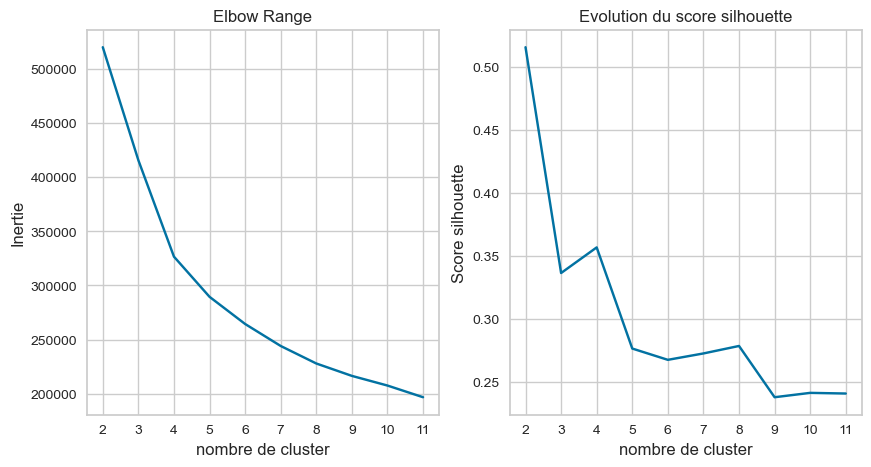

In [47]:
elbow_shilhouette(X4, k_range)

#### Visualisation pour 5 clusters

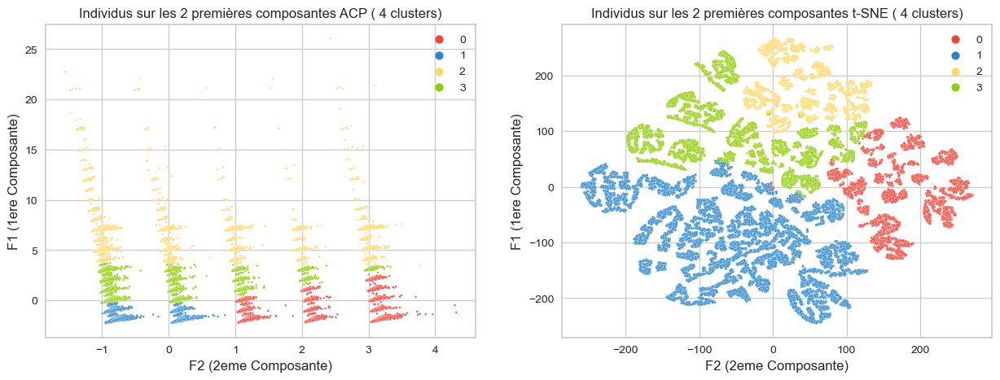

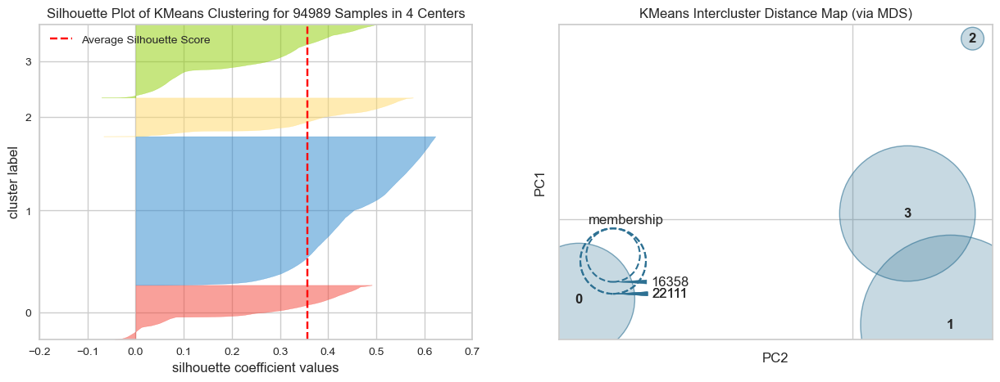

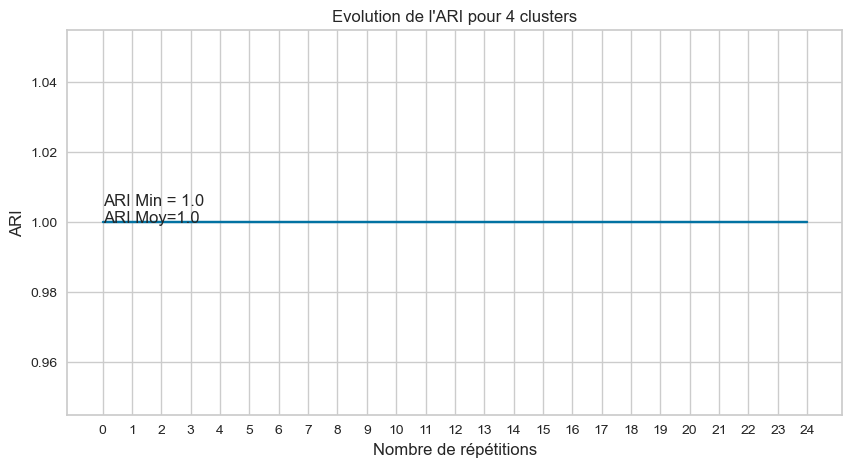

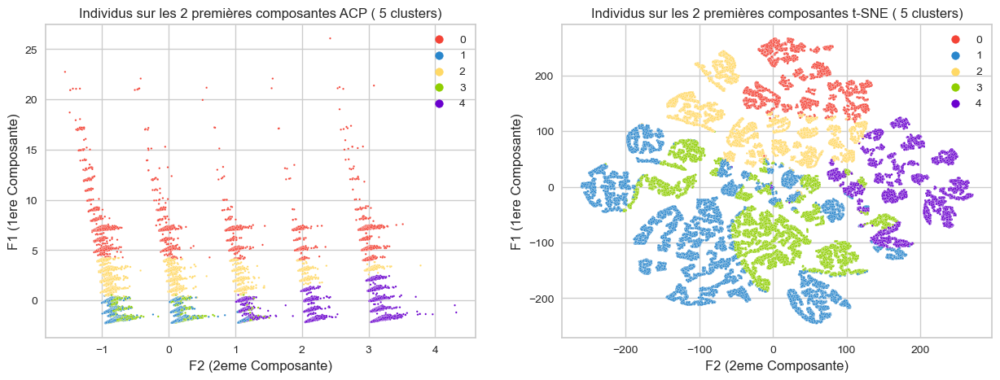

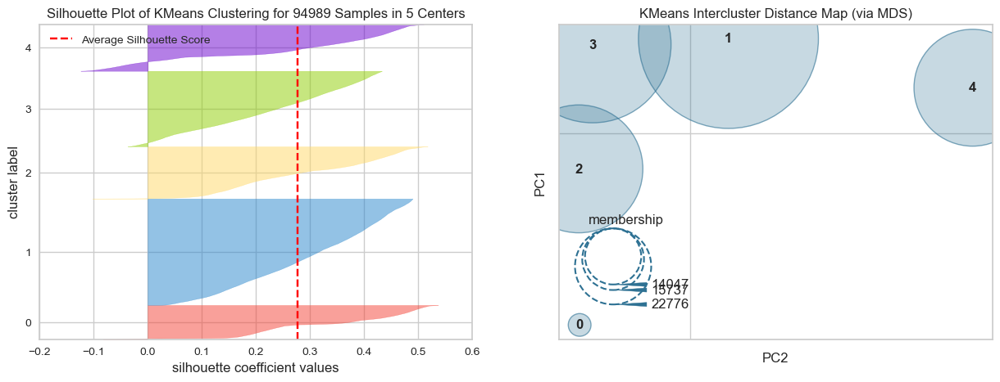

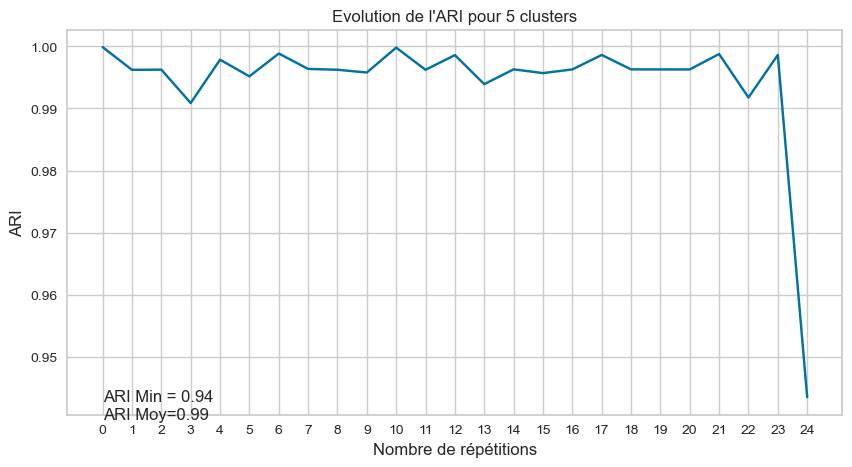

In [48]:
X4_lab, acp_X4, tsne_X4 = cls_viz(X4, [4,5])

#### Visualisation répartitions

In [49]:
X4_lab[['4_clusters','5_clusters']] = X4_lab[['4_clusters','5_clusters']].astype('str')

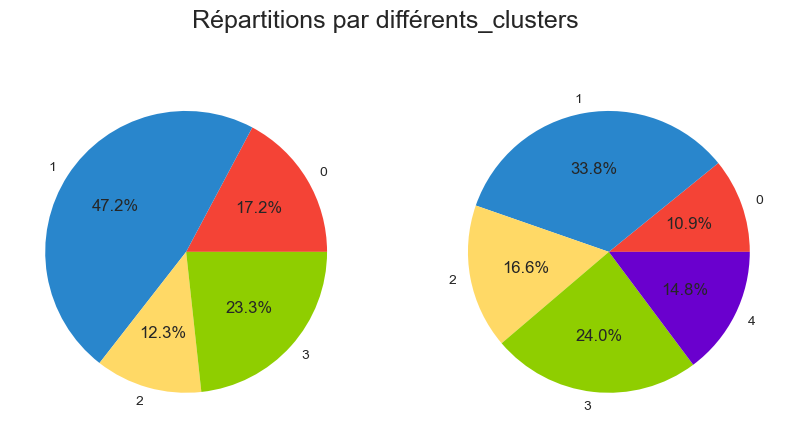

In [50]:
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
X4_4 = X4_lab['4_clusters'].value_counts()
X4_4 = X4_4.sort_index(ascending=True)
plt.pie(X4_4, labels= X4_4.index, autopct='%1.1f%%',colors=colors)
plt.subplot(1,2,2)
X4_5 = X4_lab['5_clusters'].value_counts()
X4_5 = X4_5.sort_index(ascending=True)
plt.pie(X4_5, labels= X4_5.index, autopct='%1.1f%%',colors=colors)
plt.suptitle("Répartitions par différents_clusters", fontsize=18)
plt.savefig("./Visualisations/Repartitions_df_{}_clusters".format(X4.name), bbox_inches='tight')
plt.show()

#### Visualisation des distributions

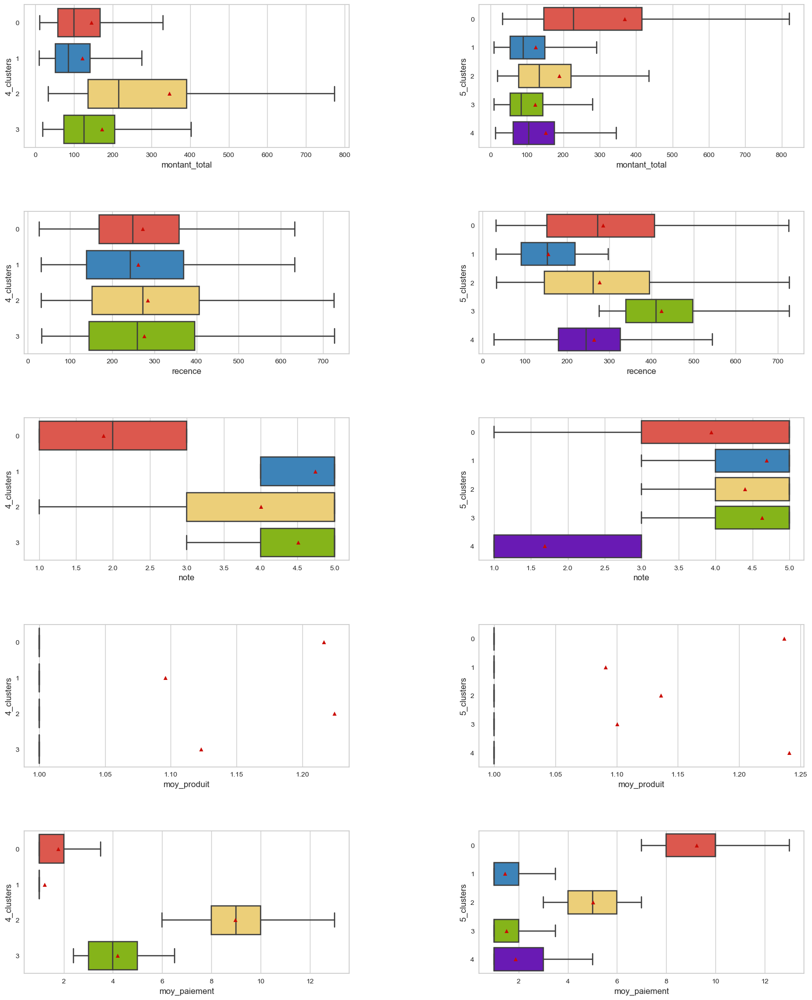

In [51]:
plt.figure(figsize=(20,25))

# Avec les 3 Clusters
plt.subplot(5,2,1)
sns.boxplot(data =  X4_lab, x='montant_total', y= '4_clusters', order=['0','1','2','3'],  showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,3)
sns.boxplot(data =  X4_lab, x='recence', y= '4_clusters',  order=['0','1','2','3'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,5)
sns.boxplot(data =  X4_lab, x='note', y= '4_clusters',  order=['0','1','2','3'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,7)
sns.boxplot(data =  X4_lab, x='moy_produit', y= '4_clusters',  order=['0','1','2','3'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,9)
sns.boxplot(data =  X4_lab, x='moy_paiement', y= '4_clusters',  order=['0','1','2','3'], showfliers=False,showmeans=True, palette=colors)

# Avec les 5 Clusters
plt.subplot(5,2,2)
sns.boxplot(data =  X4_lab, x='montant_total', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,4)
sns.boxplot(data =  X4_lab, x='recence', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,6)
sns.boxplot(data =  X4_lab, x='note', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,8)
sns.boxplot(data =  X4_lab, x='moy_produit', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,10)
sns.boxplot(data =  X4_lab, x='moy_paiement', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)

plt.subplots_adjust(hspace=0.45,wspace=0.40)
plt.savefig("./Visualisations/Distributions_df_{}_clusters".format(X4.name), bbox_inches='tight')
plt.show()

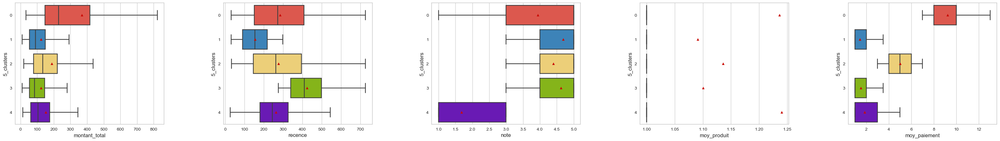

In [58]:
plt.figure(figsize=(40,5))
plt.subplot(1,5,1)
sns.boxplot(data =  X4_lab, x='montant_total', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(1,5,2)
sns.boxplot(data =  X4_lab, x='recence', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(1,5,3)
sns.boxplot(data =  X4_lab, x='note', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(1,5,4)
sns.boxplot(data =  X4_lab, x='moy_produit', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(1,5,5)
sns.boxplot(data =  X4_lab, x='moy_paiement', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)

plt.subplots_adjust(hspace=0.45,wspace=0.40)
plt.savefig("./Visualisations/Distributions_df_{}_pour_5_clusters".format(X4.name), bbox_inches='tight')
plt.show()

### Ajout de la variable groupe

In [70]:
X5 = df[['recence', 'montant_total','note','nombre_commande', 'nombre_produit', 'moy_paiement','groupe']]
X5.name='avec_ajout_groupe' #Nom du dataframme

#### Définir le choix du nombre de cluster

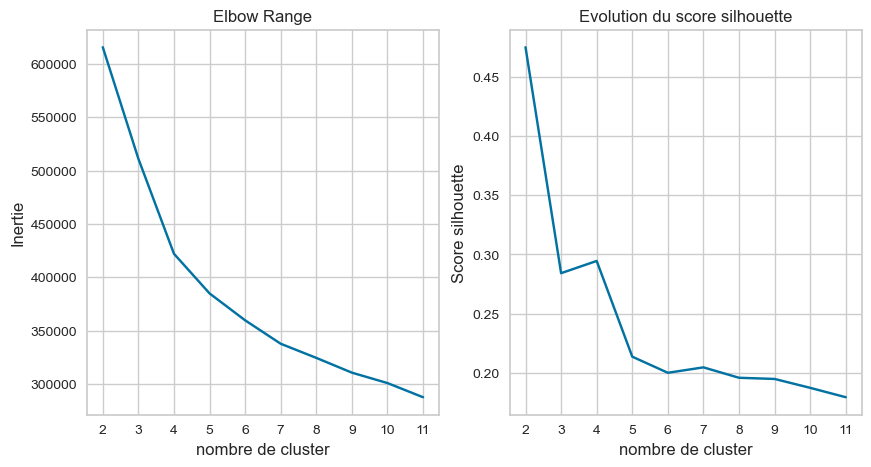

In [71]:
elbow_shilhouette(X5, k_range)

#### Visualisation pour 3, 4 clusters et 7 clusters

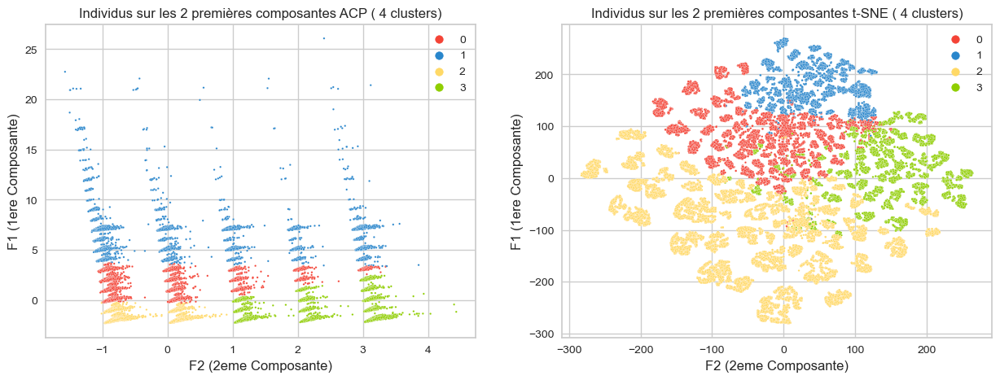

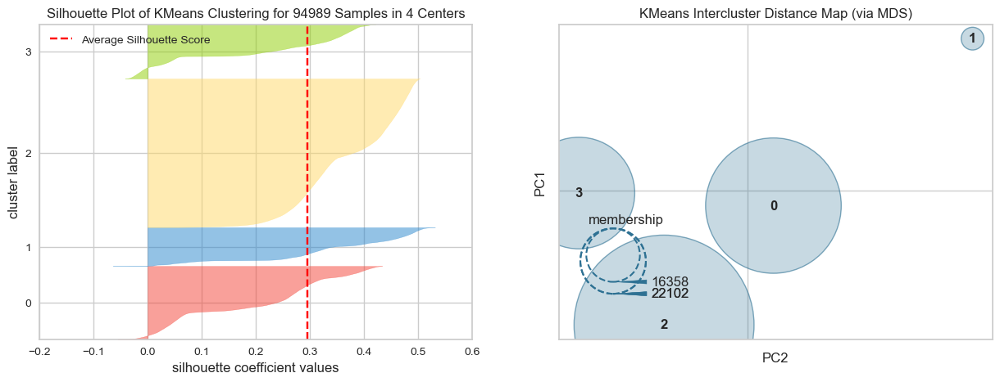

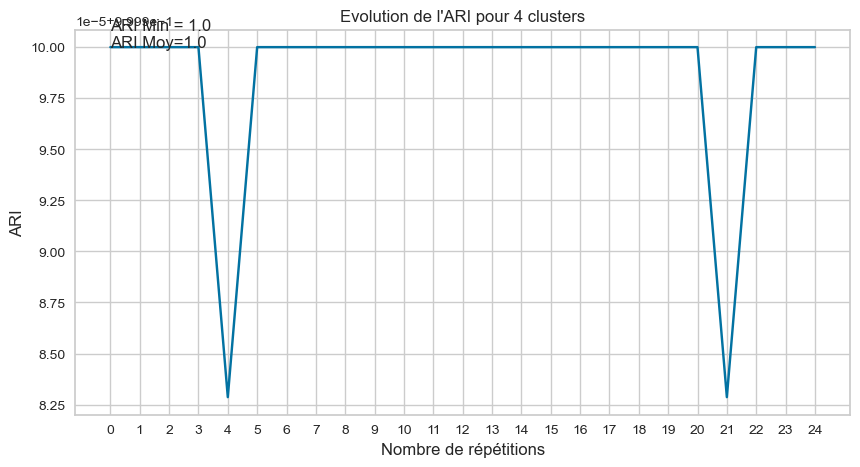

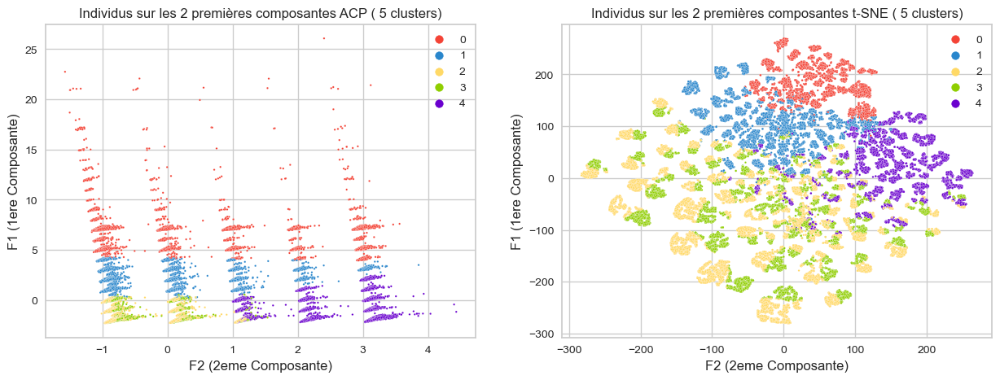

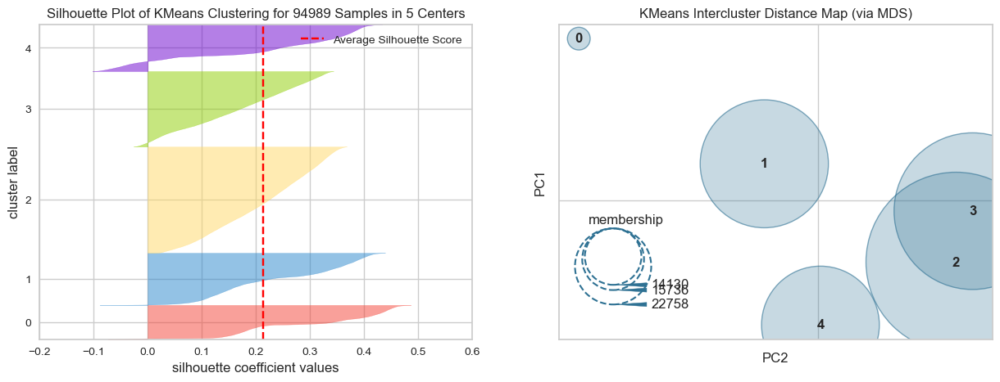

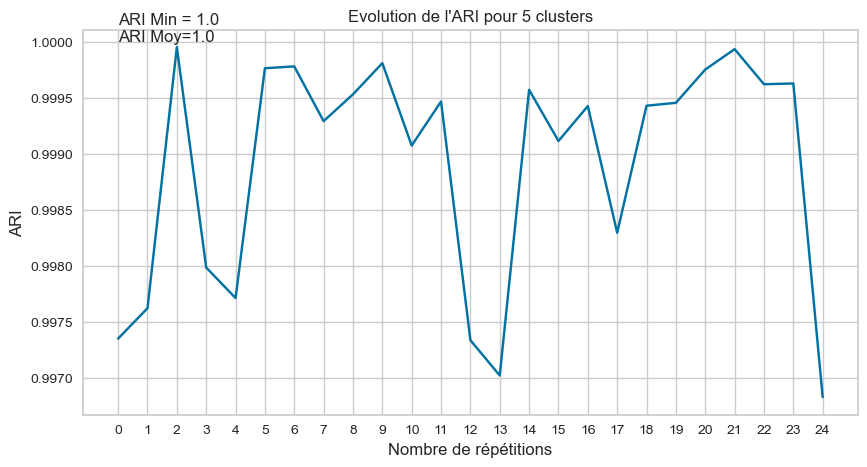

In [72]:
X5_lab, acp_X5, tsne_X5 = cls_viz(X5, [4,5])

#### Visualisation répartitions

In [73]:
X5_lab[['4_clusters','5_clusters']] = X5_lab[['4_clusters','5_clusters']].astype('str')

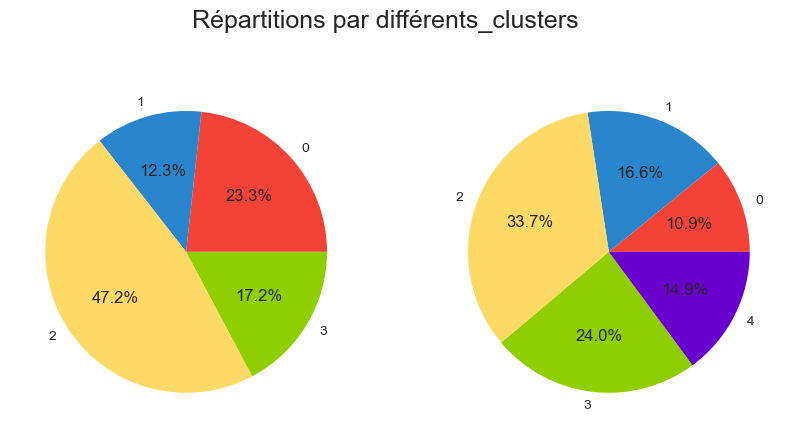

In [74]:
plt.figure(figsize=(10,5))

plt.subplot(1,2,1)
X5_4 = X5_lab['4_clusters'].value_counts()
X5_4 = X5_4.sort_index(ascending=True)
plt.pie(X5_4, labels= X5_4.index, autopct='%1.1f%%',colors=colors)
plt.suptitle("Répartitions par différents_clusters", fontsize=18)
plt.subplot(1,2,2)
X5_5 = X5_lab['5_clusters'].value_counts()
X5_5 = X5_5.sort_index(ascending=True)
plt.pie(X5_5, labels= X5_5.index, autopct='%1.1f%%',colors=colors)
plt.suptitle("Répartitions par différents_clusters", fontsize=18)
plt.savefig("./Visualisations/Repartitions_df_{}_clusters".format(X5.name), bbox_inches='tight')
plt.show()

#### Visualisation distributions

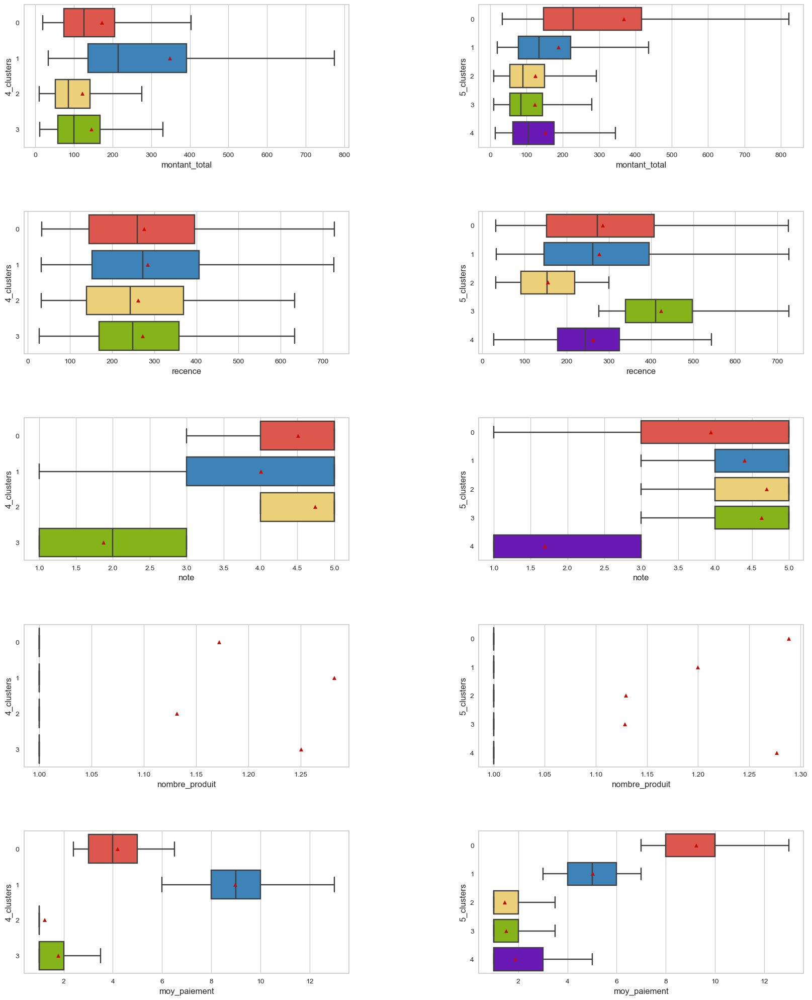

In [77]:
plt.figure(figsize=(20,25))

# Avec les 4 Clusters
plt.subplot(5,2,1)
sns.boxplot(data =  X5_lab, x='montant_total', y= '4_clusters', order=['0','1','2','3'],  showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,3)
sns.boxplot(data =  X5_lab, x='recence', y= '4_clusters',  order=['0','1','2','3'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,5)
sns.boxplot(data =  X5_lab, x='note', y= '4_clusters',  order=['0','1','2','3'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,7)
sns.boxplot(data =  X5_lab, x='nombre_produit', y= '4_clusters',  order=['0','1','2','3'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,9)
sns.boxplot(data =  X5_lab, x='moy_paiement', y= '4_clusters',  order=['0','1','2','3'], showfliers=False,showmeans=True, palette=colors)

# Avec les 5 Clusters
plt.subplot(5,2,2)
sns.boxplot(data =  X5_lab, x='montant_total', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,4)
sns.boxplot(data =  X5_lab, x='recence', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,6)
sns.boxplot(data =  X5_lab, x='note', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,8)
sns.boxplot(data =  X5_lab, x='nombre_produit', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,10)
sns.boxplot(data =  X5_lab, x='moy_paiement', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)

plt.subplots_adjust(hspace=0.45,wspace=0.40)
plt.savefig("./Visualisations/Distributions_df_{}_clusters".format(X5.name), bbox_inches='tight')
plt.show()

#### Visualisation groupe

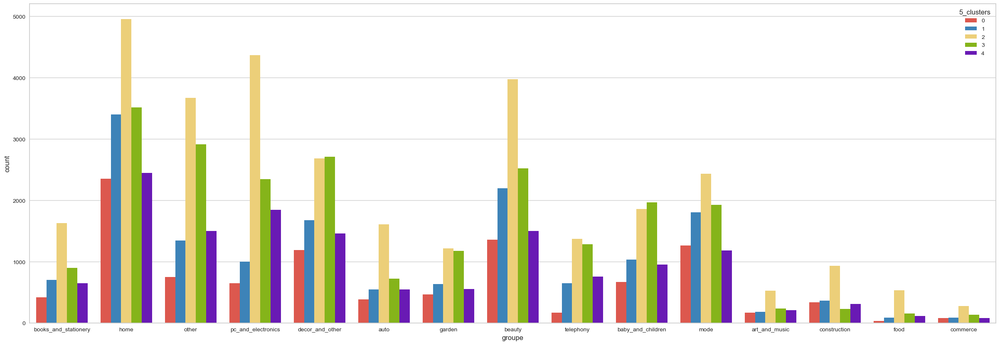

In [78]:
plt.figure(figsize=(30,10))
sns.countplot(x=X5_lab['groupe'], hue=X5_lab['5_clusters'], hue_order=['0','1','2','3','4'], palette=colors)
plt.savefig("./Visualisations/Distributions_categorie_1_df_{}_clusters".format(X5.name), bbox_inches='tight')
plt.show()

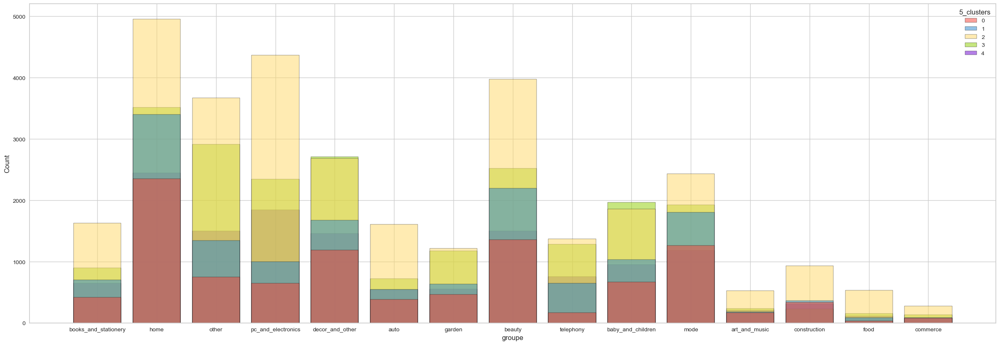

In [79]:
plt.figure(figsize=(30,10))
sns.histplot(X5_lab, x="groupe", hue="5_clusters",stat="count", multiple="layer", hue_order=['0','1','2','3','4'] ,shrink=.8, palette=colors)
plt.savefig("./Visualisations/Distributions_categorie_2_df_{}_clusters".format(X5.name), bbox_inches='tight')
plt.show()

### Toutes variables 

In [54]:
X6 = df[['recence', 'montant_total','note','nombre_commande', 'moy_paiement','moy_produit', 'groupe']]
X6.name='toutes_variables' #Nom du dataframme

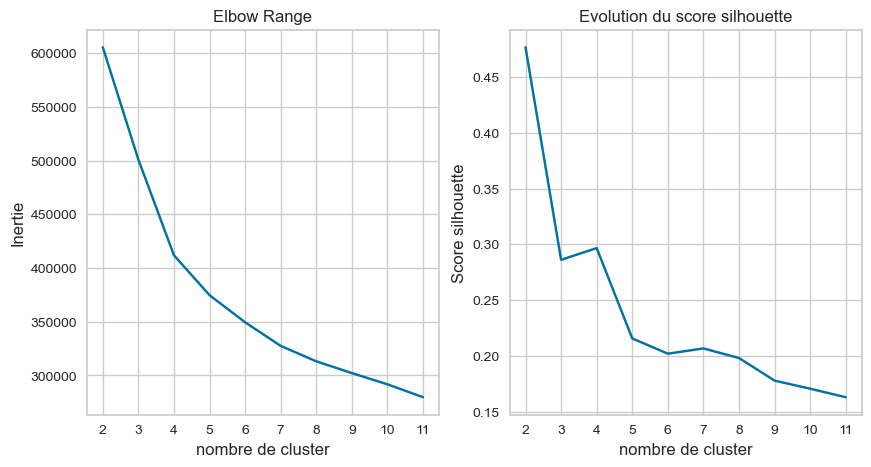

In [55]:
elbow_shilhouette(X6, k_range)

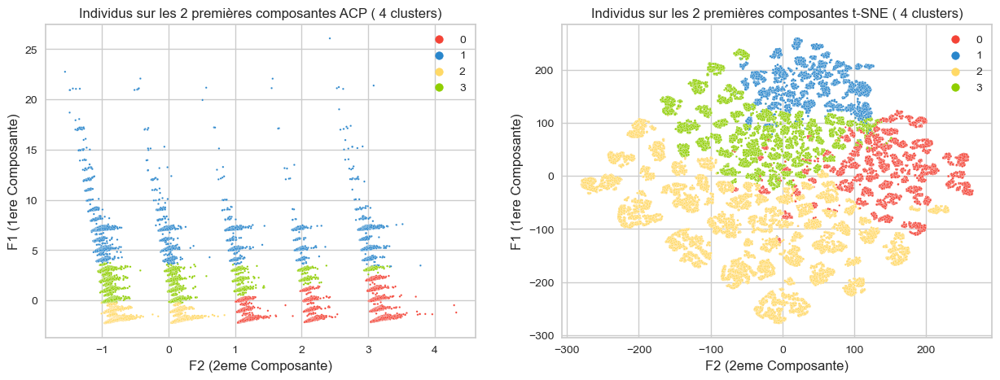

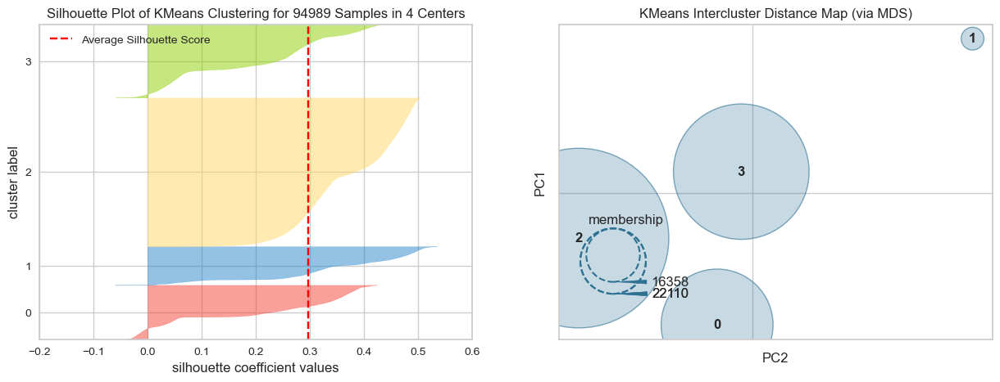

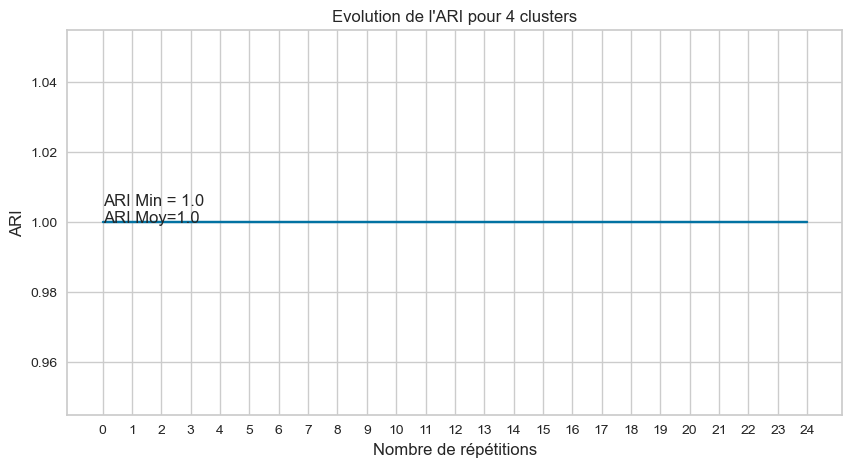

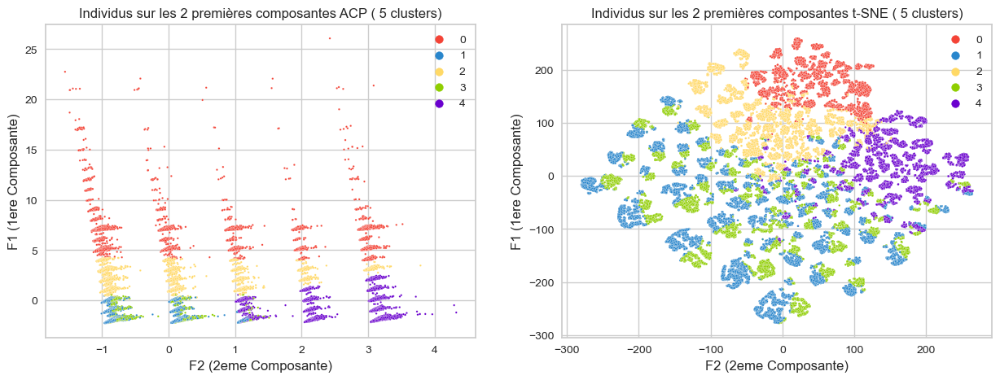

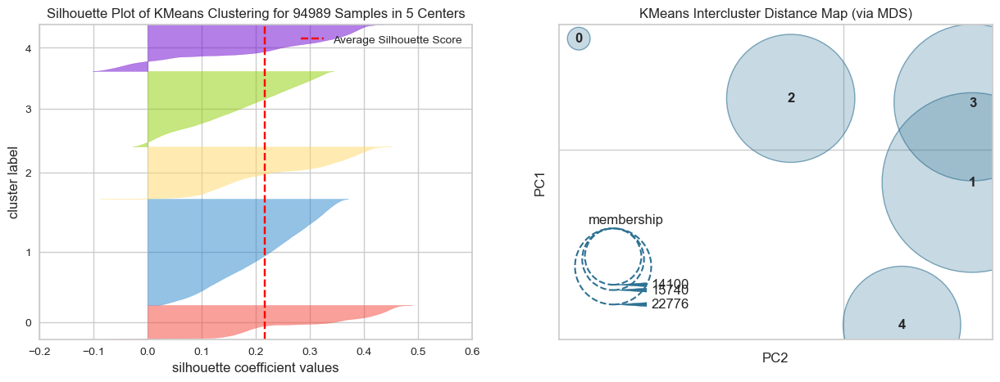

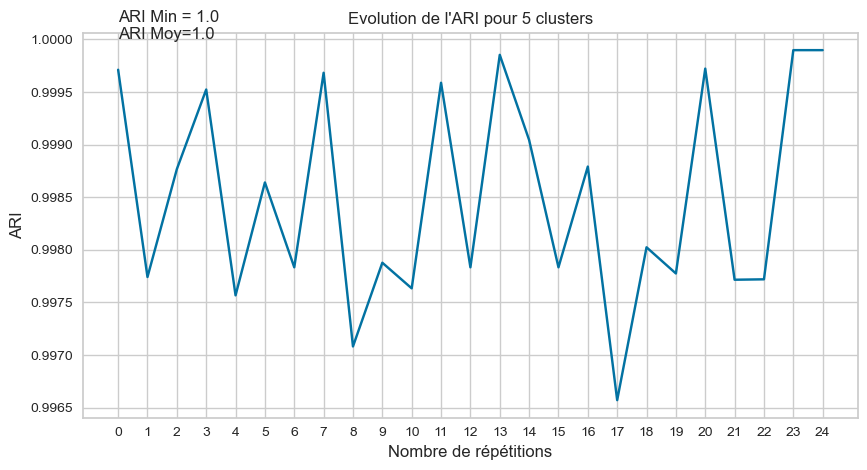

In [60]:
X6_lab, acp_X6, tsne_X6 = cls_viz(X6, [4,5])

#### Visualisation répartitions

In [61]:
X6_lab[['4_clusters','5_clusters']] = X6_lab[['4_clusters','5_clusters']].astype('str')

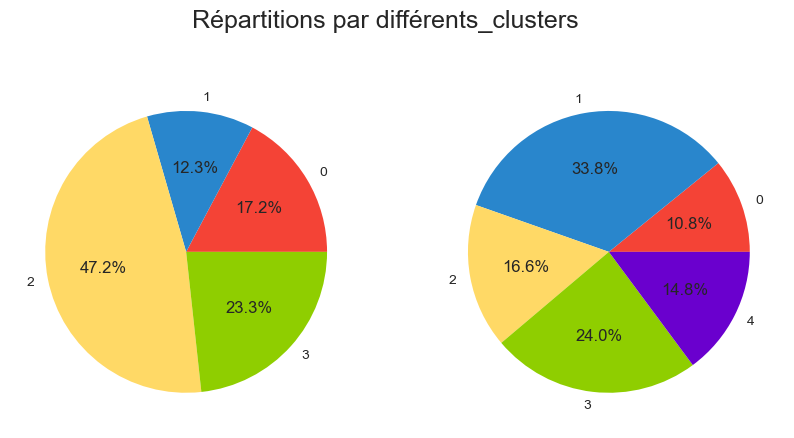

In [62]:
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
X6_4 = X6_lab['4_clusters'].value_counts()
X6_4 = X6_4.sort_index(ascending=True)
plt.pie(X6_4, labels= X6_4.index, autopct='%1.1f%%',colors=colors)
plt.subplot(1,2,2)
X6_5 = X6_lab['5_clusters'].value_counts()
X6_5 = X6_5.sort_index(ascending=True)
plt.pie(X6_5, labels= X6_5.index, autopct='%1.1f%%',colors=colors)
plt.suptitle("Répartitions par différents_clusters", fontsize=18)
plt.savefig("./Visualisations/Repartitions_df_{}_clusters".format(X6.name), bbox_inches='tight')
plt.show()

#### Visualisation distributions

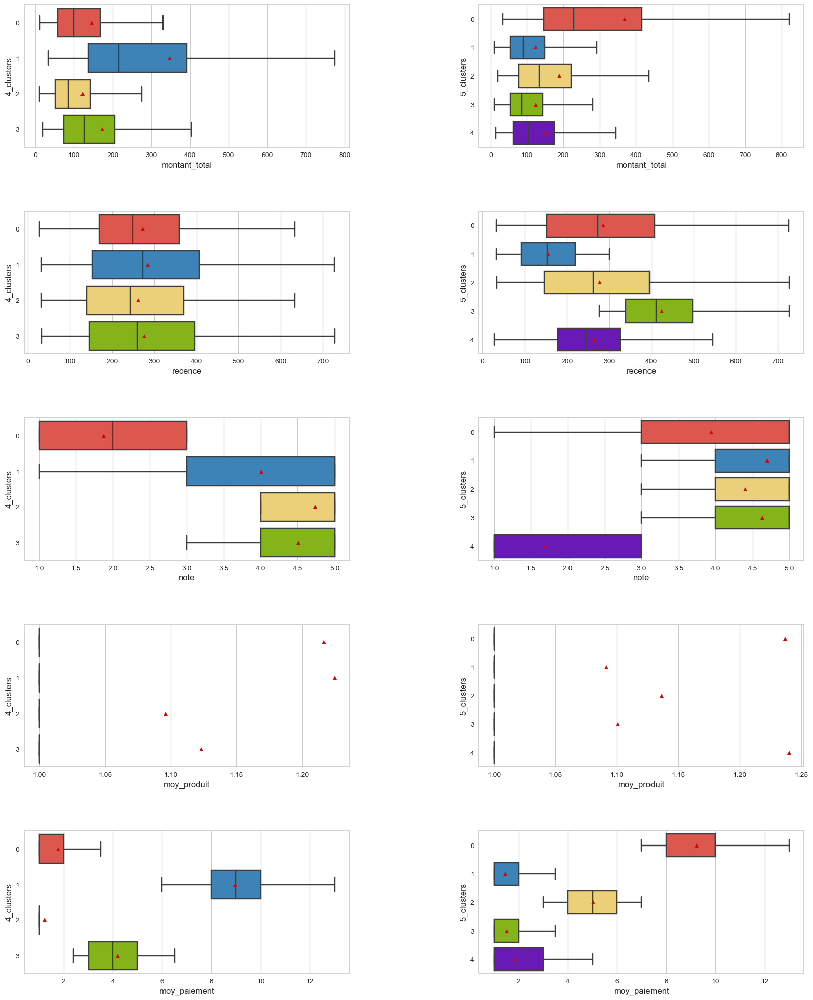

In [63]:
plt.figure(figsize=(20,25))

# Avec les 4 Clusters
plt.subplot(5,2,1)
sns.boxplot(data =  X6_lab, x='montant_total', y= '4_clusters', order=['0','1','2','3'],  showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,3)
sns.boxplot(data =  X6_lab, x='recence', y= '4_clusters',  order=['0','1','2','3'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,5)
sns.boxplot(data =  X6_lab, x='note', y= '4_clusters',  order=['0','1','2','3'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,7)
sns.boxplot(data =  X6_lab, x='moy_produit', y= '4_clusters',  order=['0','1','2','3'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,9)
sns.boxplot(data =  X6_lab, x='moy_paiement', y= '4_clusters',  order=['0','1','2','3'], showfliers=False,showmeans=True, palette=colors)

# Avec les 5 Clusters
plt.subplot(5,2,2)
sns.boxplot(data =  X6_lab, x='montant_total', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,4)
sns.boxplot(data =  X6_lab, x='recence', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,6)
sns.boxplot(data =  X6_lab, x='note', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,8)
sns.boxplot(data =  X6_lab, x='moy_produit', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(5,2,10)
sns.boxplot(data =  X6_lab, x='moy_paiement', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)

plt.subplots_adjust(hspace=0.45,wspace=0.40)
plt.savefig("./Visualisations/Distributions_df_{}_clusters".format(X6.name), bbox_inches='tight')
plt.show()

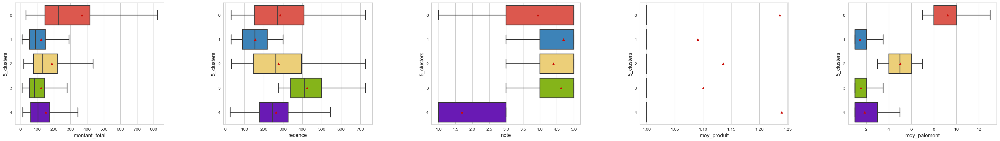

In [64]:
plt.figure(figsize=(40,5))
plt.subplot(1,5,1)
sns.boxplot(data =  X6_lab, x='montant_total', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(1,5,2)
sns.boxplot(data =  X6_lab, x='recence', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(1,5,3)
sns.boxplot(data =  X6_lab, x='note', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(1,5,4)
sns.boxplot(data =  X6_lab, x='moy_produit', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)
plt.subplot(1,5,5)
sns.boxplot(data =  X6_lab, x='moy_paiement', y= '5_clusters',  order=['0','1','2','3','4'], showfliers=False,showmeans=True, palette=colors)

plt.subplots_adjust(hspace=0.45,wspace=0.40)
plt.savefig("./Visualisations/Distributions_df_{}_pour_5_clusters".format(X6.name), bbox_inches='tight')
plt.show()

In [65]:
metrics.adjusted_rand_score(X4_lab['5_clusters'], X6_lab['5_clusters'])

0.993549696311482

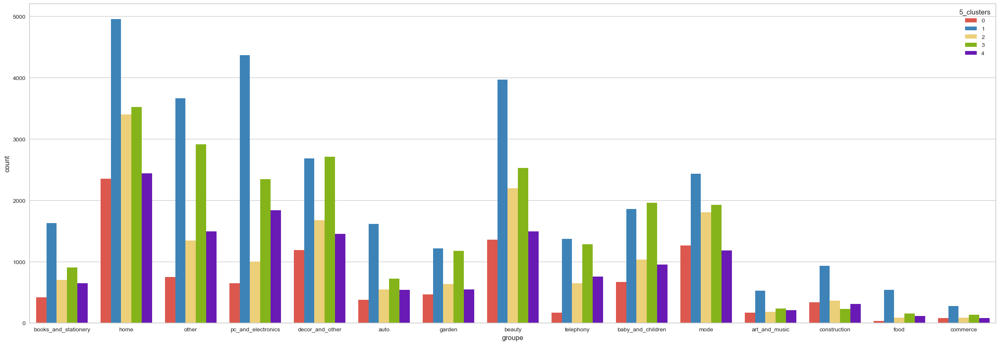

In [66]:
plt.figure(figsize=(30,10))
sns.countplot(x=X6_lab['groupe'], hue=X6_lab['5_clusters'], hue_order=['0','1','2','3','4'], palette=colors)
plt.savefig("./Visualisations/Distributions_categorie_1_df_{}_clusters".format(X6.name), bbox_inches='tight')
plt.show()

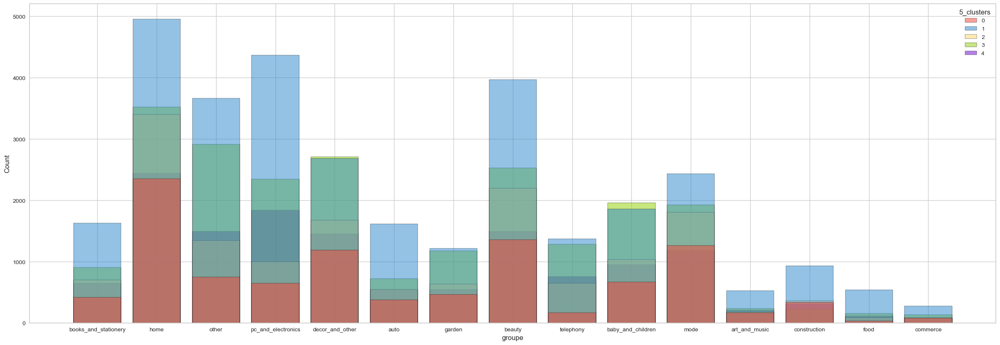

In [67]:
plt.figure(figsize=(30,10))
sns.histplot(X6_lab, x="groupe", hue="5_clusters",stat="count", multiple="layer", hue_order=['0','1','2','3','4'] ,shrink=.8, palette=colors)
plt.savefig("./Visualisations/Distributions_categorie_2_df_{}_clusters".format(X6.name), bbox_inches='tight')
plt.show()